<a href="https://colab.research.google.com/github/Sambhav300899/test-it-out/blob/master/Neural_Style_Transfer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Neural Style Transfer** is a Deep Learning technique which is used to transfer the style of one image to another, at the same time retaining the content of the original image. Here the technique proposed by Leon A. Gatys, Alexander S. Ecker, Matthias Bethge in https://arxiv.org/abs/1508.06576 is used.            

NOTE - In the paper the L-BFGS was used for optimisation but Adam has been used here instead.

The basic steps are -       
1. Take a content and style image.
2. Take a target image which will be the output.
3. Calculate the content and style loss for the target image to see how much the style and content matches the original images.
4. Calculate gradients for the target image.
5. Update the target image.
6. Repeat steps 3 to 5 for n iterations.

To perform step 3 we need some way to extract the content and style of the original images, this is done by using a pretrained CNN, as a CNN is just a collection of filters which extract relevant features from an image. The layers near the input of a CNN extract features like edges and the higher layers near the output extract features like ears and noses. One more important thing to note is that a that CNN does not learn to encode what an image is but it actually learns to encode what image represents, which means that it extracts the style and content of the image. 

Here VGG19 and VGG16 have been used for feature extraction.

<img src="https://datascience-enthusiast.com/figures/louvre_generated.png" alt="drawing"/>



**VGG19 Architecture**         
![alt text](https://www.researchgate.net/profile/Clifford_Yang/publication/325137356/figure/fig2/AS:670371271413777@1536840374533/llustration-of-the-network-architecture-of-VGG-19-model-conv-means-convolution-FC-means.jpg)

**VGG16 Architecture**                       
![alt text](https://neurohive.io/wp-content/uploads/2018/11/vgg16-1-e1542731207177.png)


Clone the repository for style and content image samples

In [0]:
!git clone https://github.com/Sambhav300899/Neural-Style-Transform-TF.git

Cloning into 'Neural-Style-Transform-TF'...
remote: Enumerating objects: 72, done.
remote: Counting objects: 100% (72/72), done.
remote: Compressing objects: 100% (60/60), done.
remote: Total 72 (delta 28), reused 41 (delta 11), pack-reused 0
Unpacking objects: 100% (72/72), done.


In [0]:
!cp -r Neural-Style-Transform-TF/content .
!cp -r Neural-Style-Transform-TF/styles .

import required libraries

In [0]:
%tensorflow_version 2.x
import cv2
import argparse
import progressbar
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import plot_model
from tensorflow.keras.applications import vgg19, vgg16

TensorFlow 2.x selected.


**Visualising the activations**      
Let's visualise the activations of VGG19, we will use a picture of a dog due to the abundance of dog pictures in imagenet. We visualise the activations for the style and content layers, and can see that the upper layers of the network extract gradients which are similar to brush strokes in a painting and the final layer contains more information about the content. One interesting thing to note here is that as we move further in the network the activations get sparser, this is due to the fact that the network is filtering out information which is not required and only firing for the class of the object.

The layers that we will use for content loss are - 'block5_conv2'    
The layers that we will use for style loss are - 'block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1'


If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.



/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:37: RuntimeWarning: invalid value encountered in true_divide


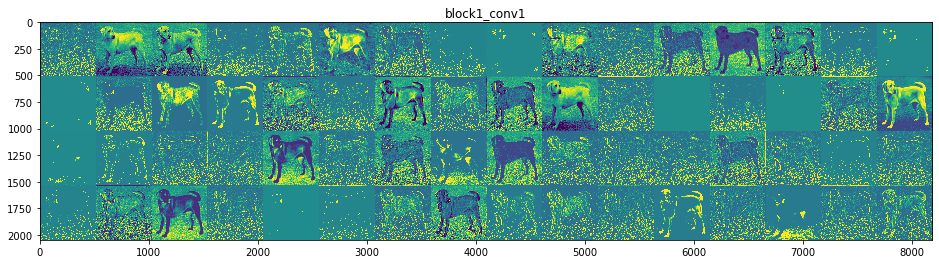

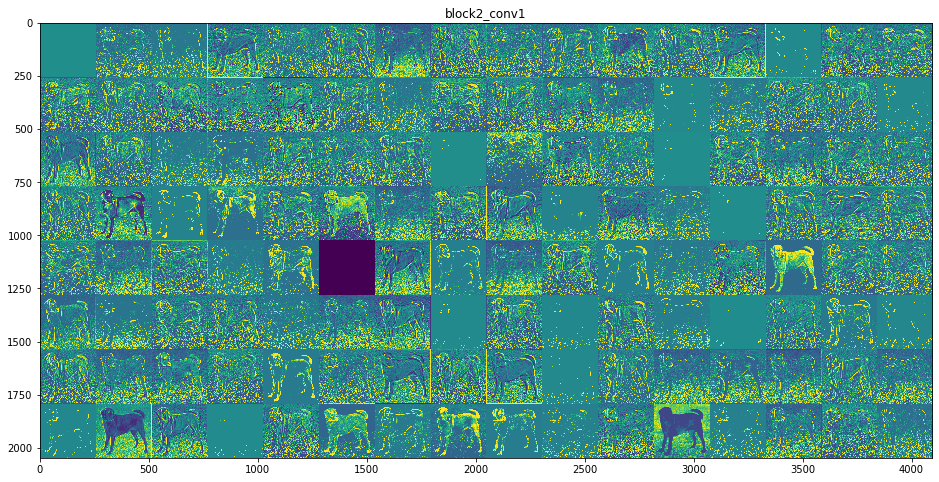

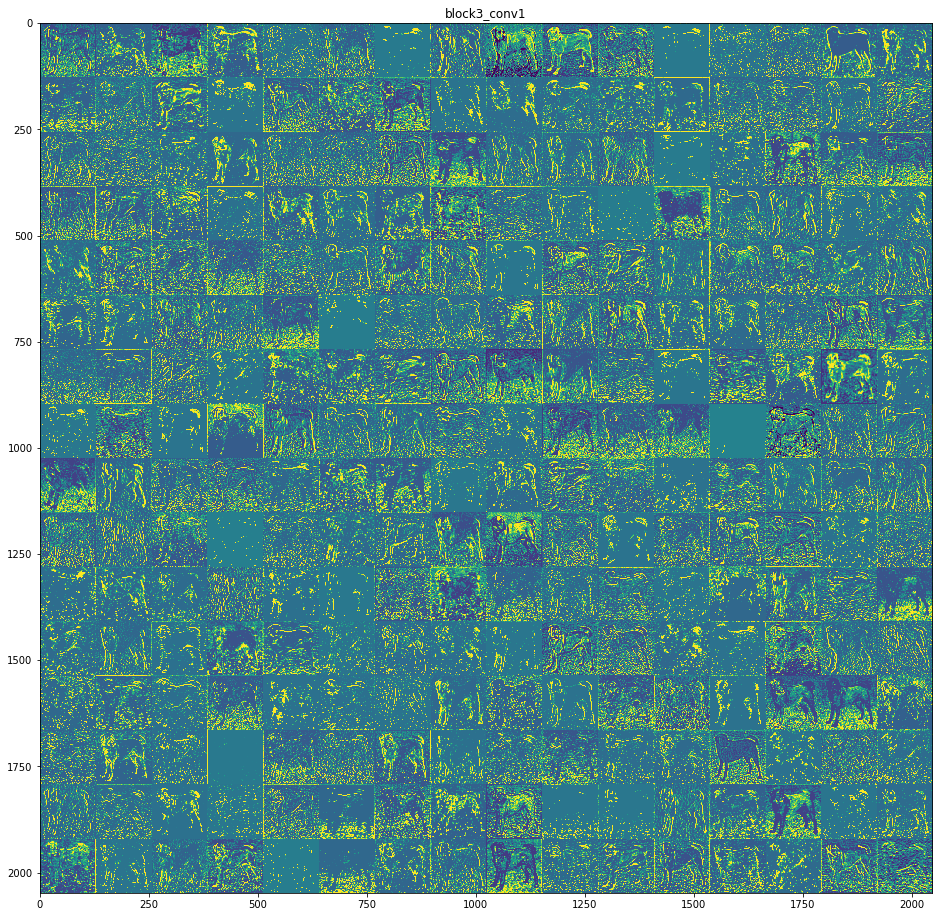

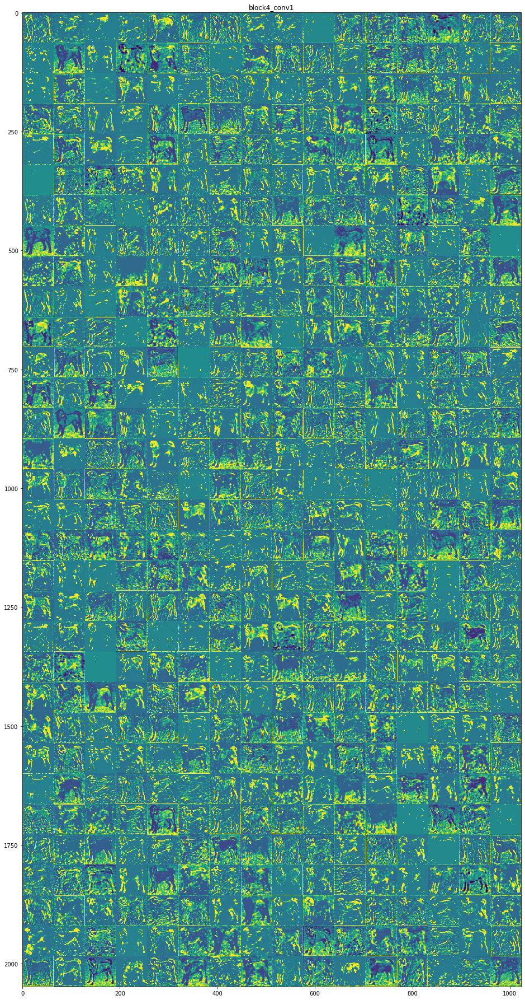

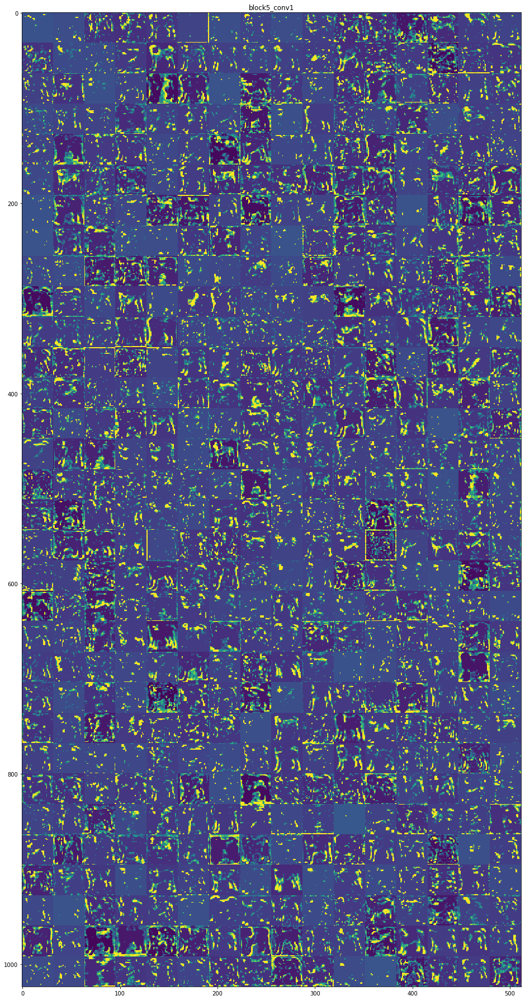

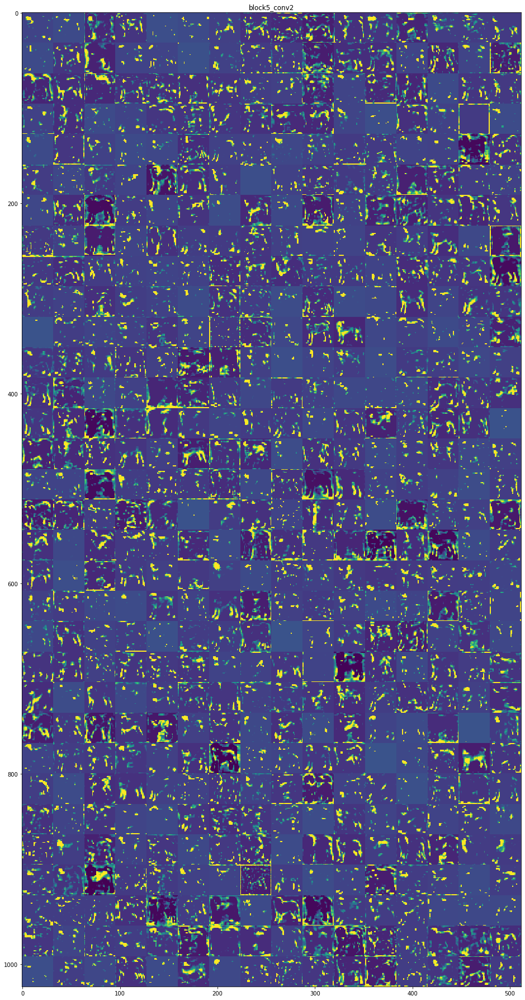

In [0]:
#function to get the model and its outputs
def get_model(shape, layers):
    base = vgg19.VGG19(include_top = False, weights = 'imagenet', input_shape = shape)
    #base.summary()

    #get the outputs from the model
    outputs = [base.get_layer(name).output for name in layers]

    model = Model(base.input, outputs)
    return model

if __name__ == "__main__":
    #the style and content layers that we use for style transfer
    layers = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1', 'block5_conv2']

    #lets load the image and resize it to make representation easier
    img = cv2.imread('content/dog.jpg')
    img = cv2.resize(img, (512, 512))
    model = get_model(img.shape, layers)

    input = np.expand_dims(img.astype('float'), axis = 0)
    input = vgg19.preprocess_input(input)

    feature_maps = model(input)
    imgs_per_row = 16

    for layer, map in zip(layers, feature_maps):
        features = map.shape[-1]
        size = map.shape[1]
        n_cols = features // imgs_per_row

        display_grid = np.zeros((size * n_cols, imgs_per_row * size))

        for col in range(n_cols):
            for row in range(imgs_per_row):
                channel_image = map.numpy()[0, :, :, col * imgs_per_row + row]
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image, 0, 255).astype(np.uint8)

                display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image

        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
        plt.title(layer)
        plt.grid(False)
        plt.imshow(display_grid, aspect='auto', cmap='viridis')


**Define utility functions** 

Here the preprocessing is used to make the input suitable for passing to the network.

VGG19 and VGG16 apply extra preprocessing to the image when it is passed to the network, to remove this and obtain the image in a suitable format we use the deprocessing function

In [0]:
def pre_proc(img):
    '''
    pre process the image to input to the network

    args - 
    img : input image to be pre processed
    '''
    img = np.array(img).astype('float')
    img = np.expand_dims(img, axis = 0)

    return img

def deprocess_img_vgg(processed_img):
  '''
  de process the image after
  passing through a VGG model

  args -
  preprocessed_image - image to be de processed
  '''
  x = processed_img.copy()

  if len(x.shape) == 4:
    x = np.squeeze(x, 0)

  x[:, :, 0] += 103.939
  x[:, :, 1] += 116.779
  x[:, :, 2] += 123.68
  x = x[:, :, ::-1]

  x = np.clip(x, 0, 255).astype('uint8')
  return x


**Define the losses**

**content loss**         
The content loss is just the Mean Squared Error between the feature map of the content image and the target image. We use this loss to keep the content the same in both of the images.  
The content loss is given by - 
![alt text](https://miro.medium.com/max/1050/1*34xPuexhGCHT7xZ17wVvDQ.jpeg)

**style loss**           
To find the style loss we use multiple output feature maps as specified above. For calculating the style loss we can't directly use the MSE between the feature maps, because style is more of a similarity measure and two images of the same style need not be exactly the same. We calculate the gram matrix of the feature maps and then find the difference between them to find the style loss. The basic idea of a gram matrix is that it finds the correlation between the channels of an image by finding the dot product between all of the channels. As we know dot product is a measure of correlation between two vectors. If we find the difference between the gram matrices of feature maps of target image and style image then we end up minimising the loss. 

The loss between gram matrices of one single layer is given by - 
![alt text](https://miro.medium.com/max/1188/1*IoozR3xGzaSqtEqGEKcWMQ.jpeg)

The total style loss is given by(wl is the loss weight of each layer)              
![alt text](https://miro.medium.com/max/533/1*n7wIYY399mOdO9jJGM6aoA.jpeg)

**Variation Loss**               
One downside to this implementation is that it produces a lot of high frequency artifacts. We can reduce this using variational loss which encourages spatial continuity and thus avoids over pixelated results. This loss is already implemented in the main tensorflow and can be called directly when calculating the loss

**Finally our total loss is a weighted average of these three losses.**



In [0]:
def gram_matrix(input_tensor):
  '''
  calculates the gram matrix of a given input tensor
  
  args - 
  input_tensor - input tensor
  '''
  channels = int(input_tensor.shape[-1])
  a = tf.reshape(input_tensor, [-1, channels])
  n = tf.shape(a)[0]
  gram = tf.matmul(a, a, transpose_a=True)
  return gram / tf.cast(n, tf.float32)

def calc_style_loss(base_style, gram_target):
  '''
  calculates the style loss for a single layer

  args - 
  base_style - the feature maps of the target image
  gram_target - the gram matrix of the style image
  '''
  gram_style = gram_matrix(base_style)

  return tf.reduce_mean(tf.square(gram_style - gram_target))

def calc_content_loss(img_op, img_content):
  '''
  calculate the content loss for a single layer

  args - 
  img_op : feature maps of target image
  img_content : feature maps of content image
  '''
  return tf.reduce_mean(tf.square(img_op - img_content))


**Define the style transfer class**

In [0]:

class style_transfer():
    '''
    A class containing the functions related to style transfer

    init args -
    model_name : can be different model types, eg vgg19, vgg16 etc.
    content_path : path to input content image
    style_path : path to input style image
    '''
    def __init__(self, model_name, content_path, style_path):
        #read images
        self.style = cv2.imread(style_path)
        self.content = cv2.imread(content_path)

        print ('STYLE IMAGE')
        cv2_imshow(self.style)
        print ('\n\nCONTENT IMAGE')
        cv2_imshow(self.content)

        self.style = cv2.resize(self.style, (self.content.shape[1], self.content.shape[0]))

        self.h, self.w = self.style.shape[:2]

        #get the model
        self.make_model(model_name)

    def get_feature_maps(self):
        '''
        get the intermediate feature outputs required to
        calculate the style and content loss
        '''
        #run the model on style and content images
        output = self.model(self.create_ip())

        #collect style and content features
        style_features = [style_layer[0] for style_layer in output[len(self.content_layers):]]
        content_features = [content_layer[1] for content_layer in output[:len(self.content_layers)]]

        return style_features, content_features

    def set_loss_weights(self, content_weight, style_weight, variation_weight):
        '''
        set the weights for how much each loss contributes to the total loss

        args -
        content_weight : weight param for content loss
        style_weight : weight param for style loss
        variation_weight : weight param for variation loss
        '''
        self.content_weight = content_weight
        self.style_weight = style_weight
        self.variation_weight = variation_weight

    def make_model(self, model_name):
        '''
        create the model according to the input model specified and
        select the layers to be used for style and content loss
        also set the loss weights according to the model

        args -
        model_name : type of model. e.g - vgg16, vgg19
        '''
        if model_name.lower() == 'vgg19':
            #get the pretrained model
            base = vgg19.VGG19(input_shape = (self.h, self.w, 3), include_top = False, weights = 'imagenet')

            #setting the content and style images
            self.content_layers = ['block5_conv2']
            self.style_layers = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']

            #get the outputs from the model
            content_outputs = [base.get_layer(name).output for name in self.content_layers]
            style_outputs = [base.get_layer(name).output for name in self.style_layers]
            model_outputs = content_outputs + style_outputs

            #set loss weights, deprocessing function and processing function
            self.set_loss_weights(1e3, 1e-2, 30)
            self.de_proc_func = deprocess_img_vgg
            self.pre_processing_func = vgg19.preprocess_input

        elif model_name.lower() == 'vgg16':
            base = vgg16.VGG16(input_shape = (self.h, self.w, 3), include_top = False, weights = 'imagenet')

            self.content_layers = ['block5_conv3'] #, 'block5_conv2']
            self.style_layers = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']

            content_outputs = [base.get_layer(name).output for name in self.content_layers]
            style_outputs = [base.get_layer(name).output for name in self.style_layers]
            model_outputs = content_outputs + style_outputs

            self.set_loss_weights(1e5, 1e-2, 1)
            self.de_proc_func = deprocess_img_vgg
            self.pre_processing_func = vgg16.preprocess_input

        #create the model
        self.model = Model(base.input, model_outputs)
        #self.model.summary()

    def calc_loss(self, combined, gram_style_features, content_features):
        '''
        calculates the combined style and content loss

        args -
        combined : the output image
        gram_style_features : gram matrices calculated for style feature maps
        content_features : content feature maps
        '''
        #get model output for the combined image
        model_op = self.model(combined)

        #get the style and content output features for the combined image
        style_op_features = model_op[len(self.content_layers):]
        content_op_features = model_op[:len(self.content_layers)]

        style_score = 0
        content_score = 0

        #calculate style score over the feature maps
        weight_per_style_layer = 1. / float(len(self.style_layers))
        for target_style, comb_style in zip(gram_style_features, style_op_features):
            style_score = style_score + weight_per_style_layer * calc_style_loss(comb_style[0], target_style)

        #calculate content score over the feature maps
        weight_per_content_layer = 1. / float(len(self.content_layers))
        for target_content, comb_content in zip(content_features, content_op_features):
            content_score = content_score + weight_per_content_layer * calc_content_loss(comb_content[0], target_content)

        style_loss = self.style_weight * style_score
        content_loss = self.content_weight * content_score
        loss = style_loss + content_loss

        return loss, style_loss, content_loss

    def create_ip(self):
        '''
        creates input to a model and performs preprocessing
        steps for the content and style image
        '''
        #change to float and expand the dims
        content_ip = pre_proc(self.content)
        style_ip = pre_proc(self.style)

        #preprocessing function of the trained model
        content_ip = self.pre_processing_func(content_ip)
        style_ip = self.pre_processing_func(style_ip)

        return np.concatenate((style_ip, content_ip))

    def combine(self, num_iter, lr, output_path, starting):
        '''
        function to combine the image. Calculates
        and updates the image by calculating the gradients

        args -
        num_iter : number of iterations to run the update loop
        lr : learing rate for the optimizer
        output_path : path to save the final image
        starting : to set the starting input as different images
        '''
        #expand dims and apply model pre processing

        if starting == 'zeros':
            combined = pre_proc(np.zeros_like(self.content))
        elif starting == 'content':
            combined = pre_proc(self.content)
        elif starting == 'style':
            combined = pre_proc(self.style)
        elif starting == 'random':
            combined = pre_proc(np.random.uniform(low = 0., high = 255.0, size = self.content.shape))
        else :
            raise Exception('{} no such starting option, please select from zeros, content, style or random'.format(starting))

        combined = self.pre_processing_func(combined)
        combined = tf.Variable(combined, dtype = tf.float32)

        #get the style and content features
        style_features, content_features = self.get_feature_maps()
        #get the gram matrices of the style features using the style feature maps
        gram_style_features = [gram_matrix(style_feature) for style_feature in style_features]
        #define out optimizer with given learning rate
        opt = Adam(lr)

        #values that the image needs to be clipped to after update
        norm_means = np.array([103.939, 116.779, 123.68])
        min_vals = -norm_means
        max_vals = 255 - norm_means

        img = None
        intermediate_images = []
        losses = []

        for i in progressbar.progressbar(range(num_iter)):
            #calculate loss and then the gradients for the combined image
            with tf.GradientTape() as tape:
                loss = self.calc_loss(combined, gram_style_features, content_features)
                variation_loss = self.variation_weight * tf.image.total_variation(combined).numpy()[0]

                total_loss, style_loss, content_loss = loss
                grads = tape.gradient(total_loss + variation_loss, combined)

            #apply the gradient updates
            opt.apply_gradients([(grads, combined)])
            clipped = tf.clip_by_value(combined, min_vals, max_vals)
            combined.assign(clipped)

            print (" total loss:{} style_loss:{} content_loss:{} variation_loss:{}".format(
                                        total_loss, style_loss, content_loss, variation_loss))

            losses.append(loss)
            img = combined.numpy()
            if i % (num_iter / 10) == 0:
                intermediate_images.append(self.de_proc_func(img[0]))

        plt.plot(range(0, num_iter), losses)
        cv2.imwrite(output_path, self.de_proc_func(img[0]))
        plt.savefig("loss.png")

        for i in range(0, len(intermediate_images)):
            intermediate_images[i] = cv2.putText(intermediate_images[i], "step {}".format(i * int(num_iter / 10)),
                                    (20, 70), cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 0, 255), cv2.LINE_AA)

        row_1 = intermediate_images[0]
        for i in range(1, 5):
            row_1 = np.hstack((row_1, intermediate_images[i]))

        row_2 = intermediate_images[5]
        for i in range(6, 10):
            row_2 = np.hstack((row_2, intermediate_images[i]))

        cv2.imwrite("intermediate_images.png", np.vstack((row_1, row_2)))
        plt.show()


Now we can finally run style transfer on an image and check the results. Some examples are shown below.

STYLE IMAGE


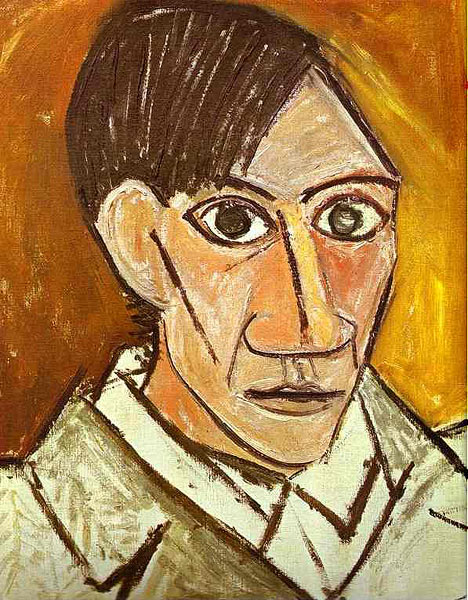



CONTENT IMAGE


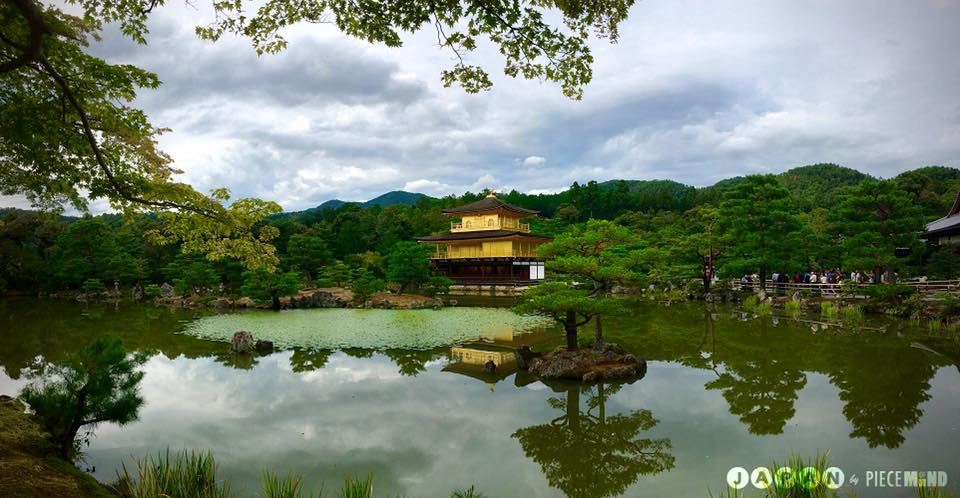


If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.



  0% (1 of 200) |                        | Elapsed Time: 0:00:00 ETA:   0:01:04

 total loss:145489312.0 style_loss:145489312.0 content_loss:6.20981097654294e-07 variation_loss:743651700.0


  1% (2 of 200) |                        | Elapsed Time: 0:00:00 ETA:   0:01:00

 total loss:70034072.0 style_loss:68993704.0 content_loss:1040368.1875 variation_loss:1067496240.0


  1% (3 of 200) |                        | Elapsed Time: 0:00:00 ETA:   0:00:59

 total loss:60272848.0 style_loss:58878484.0 content_loss:1394365.875 variation_loss:1295625360.0


  2% (4 of 200) |                        | Elapsed Time: 0:00:01 ETA:   0:00:59

 total loss:56864596.0 style_loss:55313408.0 content_loss:1551187.25 variation_loss:1436148720.0


  2% (5 of 200) |                        | Elapsed Time: 0:00:01 ETA:   0:00:58

 total loss:41046188.0 style_loss:39442972.0 content_loss:1603216.25 variation_loss:1520564520.0


  3% (6 of 200) |                        | Elapsed Time: 0:00:01 ETA:   0:00:58

 total loss:33434968.0 style_loss:31816460.0 content_loss:1618509.0 variation_loss:1586278560.0


  3% (7 of 200) |                        | Elapsed Time: 0:00:02 ETA:   0:00:57

 total loss:26854564.0 style_loss:25213380.0 content_loss:1641184.875 variation_loss:1641472320.0


  4% (8 of 200) |                        | Elapsed Time: 0:00:02 ETA:   0:00:56

 total loss:22582796.0 style_loss:20880542.0 content_loss:1702253.75 variation_loss:1684815120.0


  4% (9 of 200) |#                       | Elapsed Time: 0:00:02 ETA:   0:00:56

 total loss:19339590.0 style_loss:17576656.0 content_loss:1762934.875 variation_loss:1718329560.0


  5% (10 of 200) |#                      | Elapsed Time: 0:00:02 ETA:   0:00:56

 total loss:16964520.0 style_loss:15179067.0 content_loss:1785453.25 variation_loss:1747079880.0


  5% (11 of 200) |#                      | Elapsed Time: 0:00:03 ETA:   0:00:56

 total loss:15217436.0 style_loss:13444001.0 content_loss:1773435.25 variation_loss:1772574720.0


  6% (12 of 200) |#                      | Elapsed Time: 0:00:03 ETA:   0:00:55

 total loss:13623487.0 style_loss:11877915.0 content_loss:1745572.25 variation_loss:1792967040.0


  6% (13 of 200) |#                      | Elapsed Time: 0:00:03 ETA:   0:00:55

 total loss:12366460.0 style_loss:10633517.0 content_loss:1732943.0 variation_loss:1809212640.0


  7% (14 of 200) |#                      | Elapsed Time: 0:00:04 ETA:   0:00:54

 total loss:11372381.0 style_loss:9630261.0 content_loss:1742119.625 variation_loss:1823880960.0


  7% (15 of 200) |#                      | Elapsed Time: 0:00:04 ETA:   0:00:54

 total loss:10630679.0 style_loss:8885483.0 content_loss:1745196.0 variation_loss:1837106160.0


  8% (16 of 200) |#                      | Elapsed Time: 0:00:04 ETA:   0:00:54

 total loss:9856027.0 style_loss:8135116.5 content_loss:1720910.75 variation_loss:1846708800.0


  8% (17 of 200) |#                      | Elapsed Time: 0:00:05 ETA:   0:00:54

 total loss:9063888.0 style_loss:7381000.0 content_loss:1682888.0 variation_loss:1852800720.0


  9% (18 of 200) |##                     | Elapsed Time: 0:00:05 ETA:   0:00:53

 total loss:8594028.0 style_loss:6931698.0 content_loss:1662329.875 variation_loss:1858267440.0


  9% (19 of 200) |##                     | Elapsed Time: 0:00:05 ETA:   0:00:53

 total loss:7963557.0 style_loss:6302818.5 content_loss:1660738.375 variation_loss:1864233360.0


 10% (20 of 200) |##                     | Elapsed Time: 0:00:05 ETA:   0:00:53

 total loss:7660557.5 style_loss:6008955.5 content_loss:1651601.875 variation_loss:1869194160.0


 10% (21 of 200) |##                     | Elapsed Time: 0:00:06 ETA:   0:00:53

 total loss:7109730.5 style_loss:5489154.0 content_loss:1620576.625 variation_loss:1871845920.0


 11% (22 of 200) |##                     | Elapsed Time: 0:00:06 ETA:   0:00:53

 total loss:6860472.0 style_loss:5270729.0 content_loss:1589743.0 variation_loss:1873475520.0


 11% (23 of 200) |##                     | Elapsed Time: 0:00:06 ETA:   0:00:52

 total loss:6410504.0 style_loss:4836323.0 content_loss:1574180.875 variation_loss:1875006240.0


 12% (24 of 200) |##                     | Elapsed Time: 0:00:07 ETA:   0:00:52

 total loss:6196633.5 style_loss:4633321.0 content_loss:1563312.375 variation_loss:1875565680.0


 12% (25 of 200) |##                     | Elapsed Time: 0:00:07 ETA:   0:00:52

 total loss:5808549.0 style_loss:4268615.5 content_loss:1539933.25 variation_loss:1874365080.0


 13% (26 of 200) |##                     | Elapsed Time: 0:00:07 ETA:   0:00:51

 total loss:5590825.0 style_loss:4078057.25 content_loss:1512767.75 variation_loss:1872585240.0


 13% (27 of 200) |###                    | Elapsed Time: 0:00:08 ETA:   0:00:51

 total loss:5268402.0 style_loss:3775654.0 content_loss:1492747.875 variation_loss:1871000880.0


 14% (28 of 200) |###                    | Elapsed Time: 0:00:08 ETA:   0:00:51

 total loss:5086499.0 style_loss:3612089.5 content_loss:1474409.625 variation_loss:1868689920.0


 14% (29 of 200) |###                    | Elapsed Time: 0:00:08 ETA:   0:00:51

 total loss:4808941.0 style_loss:3360587.75 content_loss:1448353.125 variation_loss:1865076240.0


 15% (30 of 200) |###                    | Elapsed Time: 0:00:08 ETA:   0:00:50

 total loss:4641356.5 style_loss:3218576.5 content_loss:1422780.0 variation_loss:1861251120.0


 15% (31 of 200) |###                    | Elapsed Time: 0:00:09 ETA:   0:00:50

 total loss:4413238.0 style_loss:3009777.5 content_loss:1403460.375 variation_loss:1857732000.0


 16% (32 of 200) |###                    | Elapsed Time: 0:00:09 ETA:   0:00:50

 total loss:4256684.0 style_loss:2873533.0 content_loss:1383150.75 variation_loss:1853756880.0


 16% (33 of 200) |###                    | Elapsed Time: 0:00:09 ETA:   0:00:50

 total loss:4070877.0 style_loss:2713067.75 content_loss:1357809.375 variation_loss:1849196880.0


 17% (34 of 200) |###                    | Elapsed Time: 0:00:10 ETA:   0:00:49

 total loss:3924655.0 style_loss:2588035.0 content_loss:1336620.125 variation_loss:1844799360.0


 17% (35 of 200) |####                   | Elapsed Time: 0:00:10 ETA:   0:00:49

 total loss:3770205.0 style_loss:2450535.5 content_loss:1319669.625 variation_loss:1840258800.0


 18% (36 of 200) |####                   | Elapsed Time: 0:00:10 ETA:   0:00:48

 total loss:3634979.75 style_loss:2337004.0 content_loss:1297975.75 variation_loss:1834930920.0


 18% (37 of 200) |####                   | Elapsed Time: 0:00:11 ETA:   0:00:48

 total loss:3506534.0 style_loss:2232090.25 content_loss:1274443.75 variation_loss:1829499120.0


 19% (38 of 200) |####                   | Elapsed Time: 0:00:11 ETA:   0:00:48

 total loss:3385391.5 style_loss:2127529.5 content_loss:1257862.0 variation_loss:1824603360.0


 19% (39 of 200) |####                   | Elapsed Time: 0:00:11 ETA:   0:00:48

 total loss:3272777.5 style_loss:2029636.125 content_loss:1243141.5 variation_loss:1819498800.0


 20% (40 of 200) |####                   | Elapsed Time: 0:00:11 ETA:   0:00:47

 total loss:3171040.25 style_loss:1947907.5 content_loss:1223132.75 variation_loss:1813924800.0


 20% (41 of 200) |####                   | Elapsed Time: 0:00:12 ETA:   0:00:47

 total loss:3067604.5 style_loss:1864428.75 content_loss:1203175.75 variation_loss:1808645760.0


 21% (42 of 200) |####                   | Elapsed Time: 0:00:12 ETA:   0:00:47

 total loss:2979908.0 style_loss:1792223.375 content_loss:1187684.75 variation_loss:1803607800.0


 21% (43 of 200) |####                   | Elapsed Time: 0:00:12 ETA:   0:00:47

 total loss:2892705.0 style_loss:1721169.125 content_loss:1171535.875 variation_loss:1798308240.0


 22% (44 of 200) |#####                  | Elapsed Time: 0:00:13 ETA:   0:00:46

 total loss:2809362.5 style_loss:1655485.875 content_loss:1153876.625 variation_loss:1793117160.0


 22% (45 of 200) |#####                  | Elapsed Time: 0:00:13 ETA:   0:00:46

 total loss:2738127.0 style_loss:1599855.375 content_loss:1138271.5 variation_loss:1788149760.0


 23% (46 of 200) |#####                  | Elapsed Time: 0:00:13 ETA:   0:00:46

 total loss:2661622.5 style_loss:1538794.625 content_loss:1122827.875 variation_loss:1782939480.0


 23% (47 of 200) |#####                  | Elapsed Time: 0:00:14 ETA:   0:00:45

 total loss:2596832.25 style_loss:1490178.875 content_loss:1106653.375 variation_loss:1777749480.0


 24% (48 of 200) |#####                  | Elapsed Time: 0:00:14 ETA:   0:00:45

 total loss:2535664.5 style_loss:1443587.375 content_loss:1092077.125 variation_loss:1772917200.0


 24% (49 of 200) |#####                  | Elapsed Time: 0:00:14 ETA:   0:00:45

 total loss:2470257.5 style_loss:1392467.625 content_loss:1077789.875 variation_loss:1768078080.0


 25% (50 of 200) |#####                  | Elapsed Time: 0:00:14 ETA:   0:00:44

 total loss:2419219.5 style_loss:1356033.75 content_loss:1063185.875 variation_loss:1763248200.0


 25% (51 of 200) |#####                  | Elapsed Time: 0:00:15 ETA:   0:00:44

 total loss:2364765.75 style_loss:1315169.5 content_loss:1049596.25 variation_loss:1758628560.0


 26% (52 of 200) |#####                  | Elapsed Time: 0:00:15 ETA:   0:00:44

 total loss:2310973.5 style_loss:1274797.625 content_loss:1036175.875 variation_loss:1753978440.0


 26% (53 of 200) |######                 | Elapsed Time: 0:00:15 ETA:   0:00:43

 total loss:2267538.0 style_loss:1244619.5 content_loss:1022918.625 variation_loss:1749435120.0


 27% (54 of 200) |######                 | Elapsed Time: 0:00:16 ETA:   0:00:43

 total loss:2220730.0 style_loss:1210363.125 content_loss:1010366.8125 variation_loss:1745125920.0


 27% (55 of 200) |######                 | Elapsed Time: 0:00:16 ETA:   0:00:43

 total loss:2175556.5 style_loss:1177666.875 content_loss:997889.625 variation_loss:1740774720.0


 28% (56 of 200) |######                 | Elapsed Time: 0:00:16 ETA:   0:00:43

 total loss:2136886.0 style_loss:1150796.25 content_loss:986089.875 variation_loss:1736516640.0


 28% (57 of 200) |######                 | Elapsed Time: 0:00:17 ETA:   0:00:42

 total loss:2097959.75 style_loss:1123702.25 content_loss:974257.5625 variation_loss:1732392240.0


 28% (58 of 200) |######                 | Elapsed Time: 0:00:17 ETA:   0:00:42

 total loss:2058832.25 style_loss:1096631.375 content_loss:962200.875 variation_loss:1728253680.0


 29% (59 of 200) |######                 | Elapsed Time: 0:00:17 ETA:   0:00:42

 total loss:2024468.5 style_loss:1072693.25 content_loss:951775.1875 variation_loss:1724332560.0


 30% (60 of 200) |######                 | Elapsed Time: 0:00:17 ETA:   0:00:41

 total loss:1991658.625 style_loss:1050783.875 content_loss:940874.75 variation_loss:1720492800.0


 30% (61 of 200) |#######                | Elapsed Time: 0:00:18 ETA:   0:00:41

 total loss:1958430.125 style_loss:1028747.5625 content_loss:929682.5625 variation_loss:1716636720.0


 31% (62 of 200) |#######                | Elapsed Time: 0:00:18 ETA:   0:00:41

 total loss:1927396.75 style_loss:1007178.0 content_loss:920218.6875 variation_loss:1713000720.0


 31% (63 of 200) |#######                | Elapsed Time: 0:00:18 ETA:   0:00:41

 total loss:1898270.25 style_loss:988424.75 content_loss:909845.5 variation_loss:1709380680.0


 32% (64 of 200) |#######                | Elapsed Time: 0:00:19 ETA:   0:00:40

 total loss:1870008.25 style_loss:969784.9375 content_loss:900223.3125 variation_loss:1705864080.0


 32% (65 of 200) |#######                | Elapsed Time: 0:00:19 ETA:   0:00:40

 total loss:1842949.25 style_loss:951482.5625 content_loss:891466.75 variation_loss:1702486200.0


 33% (66 of 200) |#######                | Elapsed Time: 0:00:19 ETA:   0:00:40

 total loss:1817096.0 style_loss:935387.4375 content_loss:881708.625 variation_loss:1699054800.0


 33% (67 of 200) |#######                | Elapsed Time: 0:00:20 ETA:   0:00:40

 total loss:1791968.75 style_loss:918248.9375 content_loss:873719.8125 variation_loss:1695823200.0


 34% (68 of 200) |#######                | Elapsed Time: 0:00:20 ETA:   0:00:39

 total loss:1767671.5 style_loss:903066.5625 content_loss:864604.9375 variation_loss:1692609360.0


 34% (69 of 200) |#######                | Elapsed Time: 0:00:20 ETA:   0:00:39

 total loss:1744633.0 style_loss:888386.3125 content_loss:856246.6875 variation_loss:1689521280.0


 35% (70 of 200) |########               | Elapsed Time: 0:00:20 ETA:   0:00:39

 total loss:1723016.5 style_loss:874070.5625 content_loss:848945.9375 variation_loss:1686582480.0


 35% (71 of 200) |########               | Elapsed Time: 0:00:21 ETA:   0:00:38

 total loss:1702013.5 style_loss:862054.375 content_loss:839959.1875 variation_loss:1683564840.0


 36% (72 of 200) |########               | Elapsed Time: 0:00:21 ETA:   0:00:38

 total loss:1681111.75 style_loss:847723.875 content_loss:833387.875 variation_loss:1680788040.0


 36% (73 of 200) |########               | Elapsed Time: 0:00:21 ETA:   0:00:38

 total loss:1660893.0 style_loss:835563.5625 content_loss:825329.4375 variation_loss:1677966480.0


 37% (74 of 200) |########               | Elapsed Time: 0:00:22 ETA:   0:00:38

 total loss:1641518.25 style_loss:823174.5625 content_loss:818343.6875 variation_loss:1675278960.0


 37% (75 of 200) |########               | Elapsed Time: 0:00:22 ETA:   0:00:37

 total loss:1623059.625 style_loss:811855.1875 content_loss:811204.4375 variation_loss:1672622880.0


 38% (76 of 200) |########               | Elapsed Time: 0:00:22 ETA:   0:00:37

 total loss:1605511.25 style_loss:801534.25 content_loss:803977.0 variation_loss:1670024640.0


 38% (77 of 200) |########               | Elapsed Time: 0:00:23 ETA:   0:00:36

 total loss:1588458.25 style_loss:790646.25 content_loss:797812.0625 variation_loss:1667579760.0


 39% (78 of 200) |########               | Elapsed Time: 0:00:23 ETA:   0:00:36

 total loss:1571900.0 style_loss:781357.125 content_loss:790542.875 variation_loss:1665109200.0


 39% (79 of 200) |#########              | Elapsed Time: 0:00:23 ETA:   0:00:36

 total loss:1555790.75 style_loss:770819.125 content_loss:784971.6875 variation_loss:1662795600.0


 40% (80 of 200) |#########              | Elapsed Time: 0:00:23 ETA:   0:00:36

 total loss:1540442.5 style_loss:762731.3125 content_loss:777711.1875 variation_loss:1660404000.0


 40% (81 of 200) |#########              | Elapsed Time: 0:00:24 ETA:   0:00:36

 total loss:1525930.75 style_loss:753200.25 content_loss:772730.5 variation_loss:1658236800.0


 41% (82 of 200) |#########              | Elapsed Time: 0:00:24 ETA:   0:00:35

 total loss:1513167.875 style_loss:747716.4375 content_loss:765451.4375 variation_loss:1655944320.0


 41% (83 of 200) |#########              | Elapsed Time: 0:00:24 ETA:   0:00:35

 total loss:1503900.0 style_loss:742301.0 content_loss:761598.9375 variation_loss:1653938040.0


 42% (84 of 200) |#########              | Elapsed Time: 0:00:25 ETA:   0:00:35

 total loss:1503781.75 style_loss:750650.125 content_loss:753131.625 variation_loss:1651628400.0


 42% (85 of 200) |#########              | Elapsed Time: 0:00:25 ETA:   0:00:34

 total loss:1528980.75 style_loss:776416.3125 content_loss:752564.5 variation_loss:1649916960.0


 43% (86 of 200) |#########              | Elapsed Time: 0:00:25 ETA:   0:00:34

 total loss:1620294.375 style_loss:879532.0 content_loss:740762.375 variation_loss:1647399360.0


 43% (87 of 200) |##########             | Elapsed Time: 0:00:26 ETA:   0:00:34

 total loss:1895057.0 style_loss:1144919.0 content_loss:750138.0625 variation_loss:1646289360.0


 44% (88 of 200) |##########             | Elapsed Time: 0:00:26 ETA:   0:00:33

 total loss:2365234.0 style_loss:1633725.375 content_loss:731508.75 variation_loss:1643189040.0


 44% (89 of 200) |##########             | Elapsed Time: 0:00:26 ETA:   0:00:33

 total loss:2968149.25 style_loss:2212290.5 content_loss:755858.75 variation_loss:1643291760.0


 45% (90 of 200) |##########             | Elapsed Time: 0:00:26 ETA:   0:00:33

 total loss:2265782.0 style_loss:1535757.75 content_loss:730024.1875 variation_loss:1640812680.0


 45% (91 of 200) |##########             | Elapsed Time: 0:00:27 ETA:   0:00:33

 total loss:1544667.25 style_loss:813952.0625 content_loss:730715.1875 variation_loss:1640945520.0


 46% (92 of 200) |##########             | Elapsed Time: 0:00:27 ETA:   0:00:32

 total loss:1942624.875 style_loss:1198312.875 content_loss:744312.0 variation_loss:1642145400.0


 46% (93 of 200) |##########             | Elapsed Time: 0:00:27 ETA:   0:00:32

 total loss:2143272.25 style_loss:1418566.5 content_loss:724705.75 variation_loss:1639929840.0


 47% (94 of 200) |##########             | Elapsed Time: 0:00:28 ETA:   0:00:32

 total loss:1722466.625 style_loss:986668.6875 content_loss:735797.9375 variation_loss:1640476800.0


 47% (95 of 200) |##########             | Elapsed Time: 0:00:28 ETA:   0:00:31

 total loss:2042177.75 style_loss:1310251.0 content_loss:731926.75 variation_loss:1639450800.0


 48% (96 of 200) |###########            | Elapsed Time: 0:00:28 ETA:   0:00:31

 total loss:1870379.5 style_loss:1143719.125 content_loss:726660.3125 variation_loss:1639033680.0


 48% (97 of 200) |###########            | Elapsed Time: 0:00:29 ETA:   0:00:31

 total loss:1509187.875 style_loss:789367.8125 content_loss:719820.0625 variation_loss:1638629760.0


 49% (98 of 200) |###########            | Elapsed Time: 0:00:29 ETA:   0:00:30

 total loss:1678028.0 style_loss:950045.25 content_loss:727982.6875 variation_loss:1639461120.0


 49% (99 of 200) |###########            | Elapsed Time: 0:00:29 ETA:   0:00:30

 total loss:1521057.75 style_loss:803345.8125 content_loss:717711.9375 variation_loss:1638525120.0


 50% (100 of 200) |###########           | Elapsed Time: 0:00:30 ETA:   0:00:30

 total loss:1533057.0 style_loss:823971.75 content_loss:709085.3125 variation_loss:1637628240.0


 50% (101 of 200) |###########           | Elapsed Time: 0:00:30 ETA:   0:00:30

 total loss:1630671.75 style_loss:913572.375 content_loss:717099.375 variation_loss:1638234000.0


 51% (102 of 200) |###########           | Elapsed Time: 0:00:30 ETA:   0:00:29

 total loss:1420222.25 style_loss:716455.4375 content_loss:703766.875 variation_loss:1636705440.0


 51% (103 of 200) |###########           | Elapsed Time: 0:00:30 ETA:   0:00:29

 total loss:1479154.5 style_loss:780136.0 content_loss:699018.5625 variation_loss:1635720840.0


 52% (104 of 200) |###########           | Elapsed Time: 0:00:31 ETA:   0:00:29

 total loss:1462617.5 style_loss:762827.125 content_loss:699790.3125 variation_loss:1635338880.0


 52% (105 of 200) |###########           | Elapsed Time: 0:00:31 ETA:   0:00:28

 total loss:1391584.625 style_loss:700413.0 content_loss:691171.625 variation_loss:1634048400.0


 53% (106 of 200) |###########           | Elapsed Time: 0:00:31 ETA:   0:00:28

 total loss:1469945.0 style_loss:782118.0 content_loss:687826.9375 variation_loss:1633175760.0


 53% (107 of 200) |###########           | Elapsed Time: 0:00:32 ETA:   0:00:28

 total loss:1373228.75 style_loss:690070.875 content_loss:683157.9375 variation_loss:1632377040.0


 54% (108 of 200) |###########           | Elapsed Time: 0:00:32 ETA:   0:00:27

 total loss:1357888.125 style_loss:677573.6875 content_loss:680314.4375 variation_loss:1631643600.0


 54% (109 of 200) |###########           | Elapsed Time: 0:00:32 ETA:   0:00:27

 total loss:1381041.75 style_loss:707709.25 content_loss:673332.5625 variation_loss:1630167360.0


 55% (110 of 200) |############          | Elapsed Time: 0:00:33 ETA:   0:00:27

 total loss:1314988.375 style_loss:645012.9375 content_loss:669975.4375 variation_loss:1629096240.0


 55% (111 of 200) |############          | Elapsed Time: 0:00:33 ETA:   0:00:27

 total loss:1348196.25 style_loss:679678.8125 content_loss:668517.4375 variation_loss:1628236800.0


 56% (112 of 200) |############          | Elapsed Time: 0:00:33 ETA:   0:00:26

 total loss:1338229.375 style_loss:679293.375 content_loss:658936.0 variation_loss:1626429600.0


 56% (113 of 200) |############          | Elapsed Time: 0:00:33 ETA:   0:00:26

 total loss:1286062.0 style_loss:626955.8125 content_loss:659106.125 variation_loss:1625621040.0


 56% (114 of 200) |############          | Elapsed Time: 0:00:34 ETA:   0:00:26

 total loss:1306157.5 style_loss:651689.5 content_loss:654467.9375 variation_loss:1624243920.0


 57% (115 of 200) |############          | Elapsed Time: 0:00:34 ETA:   0:00:25

 total loss:1276331.25 style_loss:627293.5625 content_loss:649037.6875 variation_loss:1622870880.0


 57% (116 of 200) |############          | Elapsed Time: 0:00:34 ETA:   0:00:25

 total loss:1246359.25 style_loss:599855.125 content_loss:646504.125 variation_loss:1621763040.0


 58% (117 of 200) |############          | Elapsed Time: 0:00:35 ETA:   0:00:25

 total loss:1261336.0 style_loss:617209.6875 content_loss:644126.3125 variation_loss:1620604800.0


 59% (118 of 200) |############          | Elapsed Time: 0:00:35 ETA:   0:00:24

 total loss:1244013.5 style_loss:605227.3125 content_loss:638786.125 variation_loss:1619179440.0


 59% (119 of 200) |#############         | Elapsed Time: 0:00:35 ETA:   0:00:24

 total loss:1224234.25 style_loss:588573.8125 content_loss:635660.375 variation_loss:1617920400.0


 60% (120 of 200) |#############         | Elapsed Time: 0:00:36 ETA:   0:00:24

 total loss:1234483.0 style_loss:600205.5 content_loss:634277.5 variation_loss:1616770320.0


 60% (121 of 200) |#############         | Elapsed Time: 0:00:36 ETA:   0:00:24

 total loss:1233957.125 style_loss:607499.75 content_loss:626457.375 variation_loss:1615017840.0


 61% (122 of 200) |#############         | Elapsed Time: 0:00:36 ETA:   0:00:23

 total loss:1225235.5 style_loss:597107.6875 content_loss:628127.8125 variation_loss:1614389520.0


 61% (123 of 200) |#############         | Elapsed Time: 0:00:37 ETA:   0:00:23

 total loss:1250869.625 style_loss:630199.5625 content_loss:620670.0625 variation_loss:1612753440.0


 62% (124 of 200) |#############         | Elapsed Time: 0:00:37 ETA:   0:00:23

 total loss:1306034.75 style_loss:684908.3125 content_loss:621126.5 variation_loss:1611879000.0


 62% (125 of 200) |#############         | Elapsed Time: 0:00:37 ETA:   0:00:22

 total loss:1420204.125 style_loss:804925.3125 content_loss:615278.8125 variation_loss:1610017920.0


 63% (126 of 200) |#############         | Elapsed Time: 0:00:37 ETA:   0:00:22

 total loss:1566647.5 style_loss:945072.6875 content_loss:621574.875 variation_loss:1609902720.0


 63% (127 of 200) |#############         | Elapsed Time: 0:00:38 ETA:   0:00:22

 total loss:1839857.5 style_loss:1231760.875 content_loss:608096.6875 variation_loss:1607122080.0


 64% (128 of 200) |##############        | Elapsed Time: 0:00:38 ETA:   0:00:21

 total loss:1780796.5 style_loss:1156728.125 content_loss:624068.375 variation_loss:1608385200.0


 64% (129 of 200) |##############        | Elapsed Time: 0:00:38 ETA:   0:00:21

 total loss:1510072.5 style_loss:906127.3125 content_loss:603945.1875 variation_loss:1605420960.0


 65% (130 of 200) |##############        | Elapsed Time: 0:00:39 ETA:   0:00:21

 total loss:1228157.0 style_loss:616916.4375 content_loss:611240.5 variation_loss:1606054800.0


 65% (131 of 200) |##############        | Elapsed Time: 0:00:39 ETA:   0:00:20

 total loss:1404149.5 style_loss:790448.9375 content_loss:613700.5 variation_loss:1605889800.0


 66% (132 of 200) |##############        | Elapsed Time: 0:00:39 ETA:   0:00:20

 total loss:1458806.25 style_loss:854304.0625 content_loss:604502.1875 variation_loss:1603771680.0


 66% (133 of 200) |##############        | Elapsed Time: 0:00:40 ETA:   0:00:20

 total loss:1216285.5 style_loss:608837.8125 content_loss:607447.6875 variation_loss:1604259840.0


 67% (134 of 200) |##############        | Elapsed Time: 0:00:40 ETA:   0:00:20

 total loss:1286347.25 style_loss:676562.875 content_loss:609784.375 variation_loss:1603846200.0


 67% (135 of 200) |##############        | Elapsed Time: 0:00:40 ETA:   0:00:19

 total loss:1325730.75 style_loss:725658.625 content_loss:600072.0625 variation_loss:1601902800.0


 68% (136 of 200) |##############        | Elapsed Time: 0:00:40 ETA:   0:00:19

 total loss:1169426.0 style_loss:565604.25 content_loss:603821.6875 variation_loss:1602358680.0


 68% (137 of 200) |###############       | Elapsed Time: 0:00:41 ETA:   0:00:19

 total loss:1246165.25 style_loss:642662.3125 content_loss:603502.9375 variation_loss:1602089280.0


 69% (138 of 200) |###############       | Elapsed Time: 0:00:41 ETA:   0:00:18

 total loss:1234221.75 style_loss:639483.4375 content_loss:594738.25 variation_loss:1600461480.0


 69% (139 of 200) |###############       | Elapsed Time: 0:00:41 ETA:   0:00:18

 total loss:1145990.25 style_loss:549188.0 content_loss:596802.25 variation_loss:1600544880.0


 70% (140 of 200) |###############       | Elapsed Time: 0:00:42 ETA:   0:00:18

 total loss:1228849.5 style_loss:633956.0625 content_loss:594893.375 variation_loss:1600142880.0


 70% (141 of 200) |###############       | Elapsed Time: 0:00:42 ETA:   0:00:18

 total loss:1173211.0 style_loss:583246.1875 content_loss:589964.875 variation_loss:1598773080.0


 71% (142 of 200) |###############       | Elapsed Time: 0:00:42 ETA:   0:00:17

 total loss:1135234.5 style_loss:548245.0 content_loss:586989.5 variation_loss:1598248080.0


 71% (143 of 200) |###############       | Elapsed Time: 0:00:43 ETA:   0:00:17

 total loss:1197255.625 style_loss:608070.125 content_loss:589185.5 variation_loss:1598126520.0


 72% (144 of 200) |###############       | Elapsed Time: 0:00:43 ETA:   0:00:17

 total loss:1139795.625 style_loss:558435.6875 content_loss:581359.9375 variation_loss:1596781440.0


 72% (145 of 200) |###############       | Elapsed Time: 0:00:43 ETA:   0:00:16

 total loss:1141422.25 style_loss:559041.875 content_loss:582380.375 variation_loss:1596297120.0


 73% (146 of 200) |################      | Elapsed Time: 0:00:43 ETA:   0:00:16

 total loss:1181019.0 style_loss:602247.3125 content_loss:578771.6875 variation_loss:1595693280.0


 73% (147 of 200) |################      | Elapsed Time: 0:00:44 ETA:   0:00:16

 total loss:1149676.75 style_loss:570849.6875 content_loss:578827.125 variation_loss:1594937760.0


 74% (148 of 200) |################      | Elapsed Time: 0:00:44 ETA:   0:00:15

 total loss:1176079.25 style_loss:604864.25 content_loss:571215.0 variation_loss:1593719760.0


 74% (149 of 200) |################      | Elapsed Time: 0:00:44 ETA:   0:00:15

 total loss:1217189.75 style_loss:639724.5625 content_loss:577465.25 variation_loss:1593684840.0


 75% (150 of 200) |################      | Elapsed Time: 0:00:45 ETA:   0:00:15

 total loss:1193697.25 style_loss:626922.6875 content_loss:566774.625 variation_loss:1592314080.0


 75% (151 of 200) |################      | Elapsed Time: 0:00:45 ETA:   0:00:14

 total loss:1199173.0 style_loss:628147.875 content_loss:571025.0625 variation_loss:1592043240.0


 76% (152 of 200) |################      | Elapsed Time: 0:00:45 ETA:   0:00:14

 total loss:1179447.75 style_loss:613793.5625 content_loss:565654.125 variation_loss:1591453200.0


 76% (153 of 200) |################      | Elapsed Time: 0:00:46 ETA:   0:00:14

 total loss:1113207.75 style_loss:549173.125 content_loss:564034.5625 variation_loss:1590603120.0


 77% (154 of 200) |################      | Elapsed Time: 0:00:46 ETA:   0:00:14

 total loss:1084061.75 style_loss:521443.3125 content_loss:562618.375 variation_loss:1590197280.0


 77% (155 of 200) |#################     | Elapsed Time: 0:00:46 ETA:   0:00:13

 total loss:1115275.25 style_loss:556016.0 content_loss:559259.1875 variation_loss:1589347440.0


 78% (156 of 200) |#################     | Elapsed Time: 0:00:47 ETA:   0:00:13

 total loss:1139282.5 style_loss:578499.1875 content_loss:560783.3125 variation_loss:1589025360.0


 78% (157 of 200) |#################     | Elapsed Time: 0:00:47 ETA:   0:00:13

 total loss:1184899.625 style_loss:630169.125 content_loss:554730.5 variation_loss:1587798720.0


 79% (158 of 200) |#################     | Elapsed Time: 0:00:47 ETA:   0:00:12

 total loss:1234812.125 style_loss:675614.125 content_loss:559198.0 variation_loss:1587965160.0


 79% (159 of 200) |#################     | Elapsed Time: 0:00:47 ETA:   0:00:12

 total loss:1255628.75 style_loss:704405.6875 content_loss:551223.0 variation_loss:1586407680.0


 80% (160 of 200) |#################     | Elapsed Time: 0:00:48 ETA:   0:00:12

 total loss:1233078.25 style_loss:678875.125 content_loss:554203.0625 variation_loss:1586803680.0


 80% (161 of 200) |#################     | Elapsed Time: 0:00:48 ETA:   0:00:11

 total loss:1272771.75 style_loss:722391.25 content_loss:550380.5 variation_loss:1585500000.0


 81% (162 of 200) |#################     | Elapsed Time: 0:00:48 ETA:   0:00:11

 total loss:1295208.75 style_loss:745875.0 content_loss:549333.8125 variation_loss:1585524600.0


 81% (163 of 200) |#################     | Elapsed Time: 0:00:49 ETA:   0:00:11

 total loss:1330029.5 style_loss:776727.4375 content_loss:553302.0 variation_loss:1584968160.0


 82% (164 of 200) |##################    | Elapsed Time: 0:00:49 ETA:   0:00:10

 total loss:1273777.0 style_loss:728311.75 content_loss:545465.25 variation_loss:1584423120.0


 82% (165 of 200) |##################    | Elapsed Time: 0:00:49 ETA:   0:00:10

 total loss:1221717.75 style_loss:669351.625 content_loss:552366.1875 variation_loss:1584522000.0


 83% (166 of 200) |##################    | Elapsed Time: 0:00:50 ETA:   0:00:10

 total loss:1141437.125 style_loss:597936.9375 content_loss:543500.1875 variation_loss:1583852280.0


 83% (167 of 200) |##################    | Elapsed Time: 0:00:50 ETA:   0:00:10

 total loss:1083378.125 style_loss:537647.1875 content_loss:545730.9375 variation_loss:1584049680.0


 84% (168 of 200) |##################    | Elapsed Time: 0:00:50 ETA:   0:00:09

 total loss:1122362.25 style_loss:577794.0625 content_loss:544568.1875 variation_loss:1583327520.0


 84% (169 of 200) |##################    | Elapsed Time: 0:00:50 ETA:   0:00:09

 total loss:1144053.875 style_loss:601690.4375 content_loss:542363.4375 variation_loss:1583326800.0


 85% (170 of 200) |##################    | Elapsed Time: 0:00:51 ETA:   0:00:09

 total loss:1071350.875 style_loss:529624.1875 content_loss:541726.6875 variation_loss:1582670880.0


 85% (171 of 200) |##################    | Elapsed Time: 0:00:51 ETA:   0:00:08

 total loss:1006963.875 style_loss:466607.3125 content_loss:540356.5625 variation_loss:1582447680.0


 86% (172 of 200) |##################    | Elapsed Time: 0:00:51 ETA:   0:00:08

 total loss:1056280.5 style_loss:519150.03125 content_loss:537130.5 variation_loss:1582089480.0


 86% (173 of 200) |###################   | Elapsed Time: 0:00:52 ETA:   0:00:08

 total loss:1086219.75 style_loss:547412.375 content_loss:538807.4375 variation_loss:1581556560.0


 87% (174 of 200) |###################   | Elapsed Time: 0:00:52 ETA:   0:00:07

 total loss:1021078.5625 style_loss:486626.0 content_loss:534452.5625 variation_loss:1581394080.0


 87% (175 of 200) |###################   | Elapsed Time: 0:00:52 ETA:   0:00:07

 total loss:993493.5625 style_loss:460354.0 content_loss:533139.5625 variation_loss:1580928720.0


 88% (176 of 200) |###################   | Elapsed Time: 0:00:53 ETA:   0:00:07

 total loss:1020035.25 style_loss:487263.78125 content_loss:532771.4375 variation_loss:1580415360.0


 88% (177 of 200) |###################   | Elapsed Time: 0:00:53 ETA:   0:00:06

 total loss:1008683.5625 style_loss:478228.5625 content_loss:530455.0 variation_loss:1579985520.0


 89% (178 of 200) |###################   | Elapsed Time: 0:00:53 ETA:   0:00:06

 total loss:986134.0 style_loss:457878.65625 content_loss:528255.375 variation_loss:1579323840.0


 89% (179 of 200) |###################   | Elapsed Time: 0:00:53 ETA:   0:00:06

 total loss:995352.6875 style_loss:467218.75 content_loss:528133.9375 variation_loss:1579014840.0


 90% (180 of 200) |###################   | Elapsed Time: 0:00:54 ETA:   0:00:06

 total loss:997136.1875 style_loss:472345.4375 content_loss:524790.75 variation_loss:1578293640.0


 90% (181 of 200) |###################   | Elapsed Time: 0:00:54 ETA:   0:00:05

 total loss:980847.25 style_loss:456661.0625 content_loss:524186.21875 variation_loss:1577932800.0


 91% (182 of 200) |####################  | Elapsed Time: 0:00:54 ETA:   0:00:05

 total loss:993249.5 style_loss:471915.1875 content_loss:521334.34375 variation_loss:1577177280.0


 91% (183 of 200) |####################  | Elapsed Time: 0:00:55 ETA:   0:00:05

 total loss:1038952.625 style_loss:515756.5625 content_loss:523196.09375 variation_loss:1576992480.0


 92% (184 of 200) |####################  | Elapsed Time: 0:00:55 ETA:   0:00:04

 total loss:1132192.25 style_loss:616437.8125 content_loss:515754.40625 variation_loss:1575498960.0


 92% (185 of 200) |####################  | Elapsed Time: 0:00:55 ETA:   0:00:04

 total loss:1369410.5 style_loss:839770.0 content_loss:529640.5625 variation_loss:1576458480.0


 93% (186 of 200) |####################  | Elapsed Time: 0:00:56 ETA:   0:00:04

 total loss:2013795.5 style_loss:1502648.5 content_loss:511146.9375 variation_loss:1573377120.0


 93% (187 of 200) |####################  | Elapsed Time: 0:00:56 ETA:   0:00:03

 total loss:2602431.75 style_loss:2055333.5 content_loss:547098.1875 variation_loss:1576534080.0


 94% (188 of 200) |####################  | Elapsed Time: 0:00:56 ETA:   0:00:03

 total loss:2649700.0 style_loss:2131239.25 content_loss:518460.6875 variation_loss:1572541920.0


 94% (189 of 200) |####################  | Elapsed Time: 0:00:57 ETA:   0:00:03

 total loss:1254718.625 style_loss:718899.5625 content_loss:535819.0625 variation_loss:1576681200.0


 95% (190 of 200) |####################  | Elapsed Time: 0:00:57 ETA:   0:00:03

 total loss:1393080.5 style_loss:842899.25 content_loss:550181.25 variation_loss:1578313200.0


 95% (191 of 200) |##################### | Elapsed Time: 0:00:57 ETA:   0:00:02

 total loss:2211482.25 style_loss:1669320.75 content_loss:542161.4375 variation_loss:1576654560.0


 96% (192 of 200) |##################### | Elapsed Time: 0:00:57 ETA:   0:00:02

 total loss:1848561.75 style_loss:1281978.875 content_loss:566582.8125 variation_loss:1581149040.0


 96% (193 of 200) |##################### | Elapsed Time: 0:00:58 ETA:   0:00:02

 total loss:3152585.25 style_loss:2586911.75 content_loss:565673.5625 variation_loss:1582464720.0


 97% (194 of 200) |##################### | Elapsed Time: 0:00:58 ETA:   0:00:01

 total loss:7523475.5 style_loss:6915623.5 content_loss:607852.0 variation_loss:1581783960.0


 97% (195 of 200) |##################### | Elapsed Time: 0:00:58 ETA:   0:00:01

 total loss:3799616.5 style_loss:3214255.25 content_loss:585361.25 variation_loss:1590029760.0


 98% (196 of 200) |##################### | Elapsed Time: 0:00:59 ETA:   0:00:01

 total loss:3494995.5 style_loss:2860569.75 content_loss:634425.75 variation_loss:1598701920.0


 98% (197 of 200) |##################### | Elapsed Time: 0:00:59 ETA:   0:00:00

 total loss:3746507.5 style_loss:3106029.0 content_loss:640478.5 variation_loss:1603559520.0


 99% (198 of 200) |##################### | Elapsed Time: 0:00:59 ETA:   0:00:00

 total loss:2471494.0 style_loss:1805070.5 content_loss:666423.4375 variation_loss:1614327000.0


 99% (199 of 200) |##################### | Elapsed Time: 0:01:00 ETA:   0:00:00

 total loss:2720702.25 style_loss:2033086.0 content_loss:687616.3125 variation_loss:1617771120.0


100% (200 of 200) |######################| Elapsed Time: 0:01:00 Time:  0:01:00


 total loss:2907034.0 style_loss:2228566.0 content_loss:678468.0 variation_loss:1619786760.0


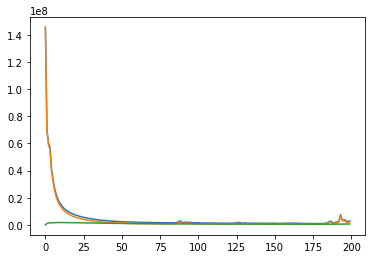

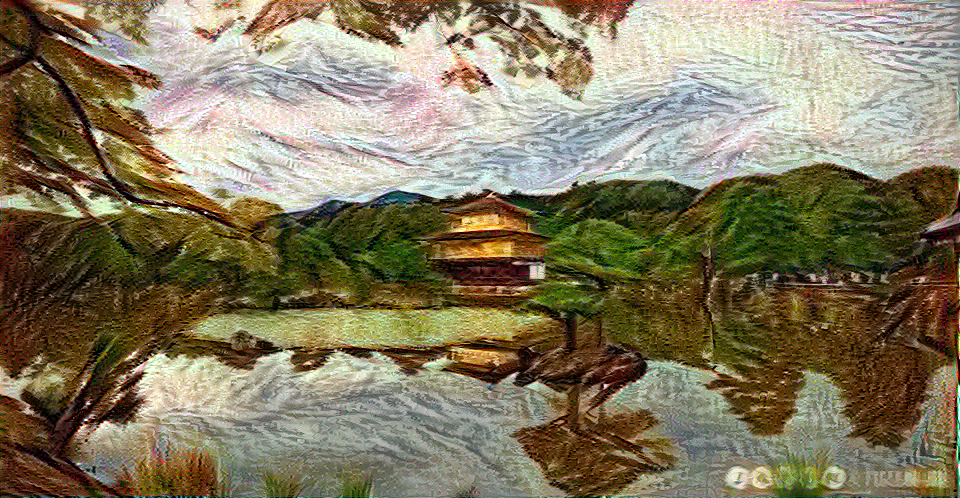



the intermediate outputs are :


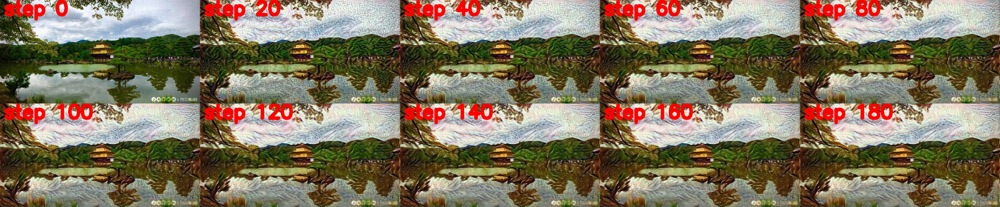

In [0]:
style_transfer_net = style_transfer('vgg19', 'content/content.jpg', 'styles/style.jpg')
style_transfer_net.combine(200, 10, 'output.png', 'content')

output = cv2.imread('output.png')
intermediate_image = cv2.imread('intermediate_images.png')
w = 512
r = intermediate_image.shape[0] / w
intermediate_image = cv2.resize(intermediate_image, (int(intermediate_image.shape[1] / r), w))
cv2_imshow(output)

print ("\n\nthe intermediate outputs are :")
cv2_imshow(intermediate_image)

STYLE IMAGE


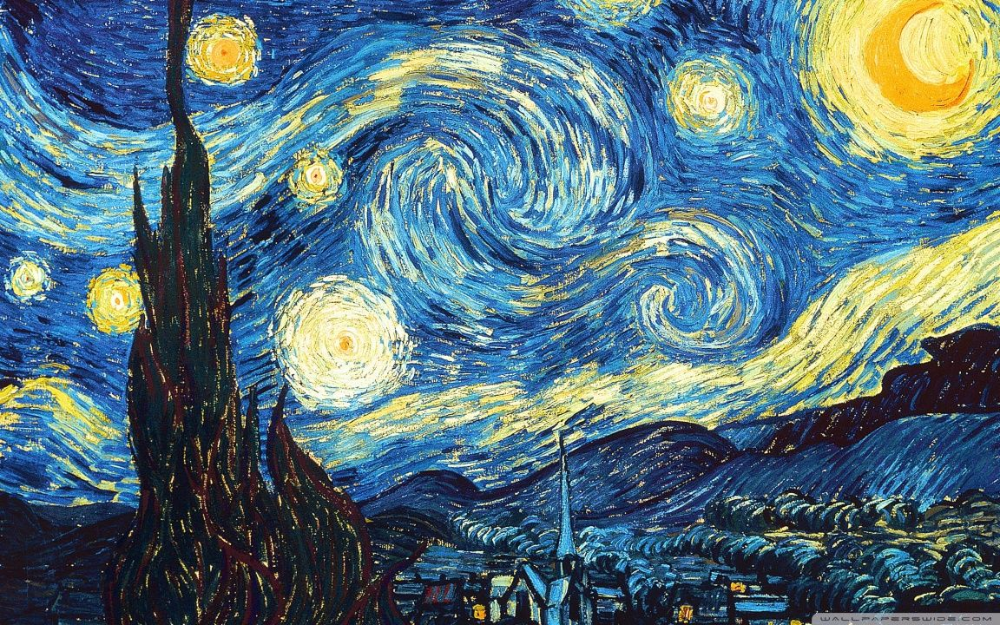



CONTENT IMAGE


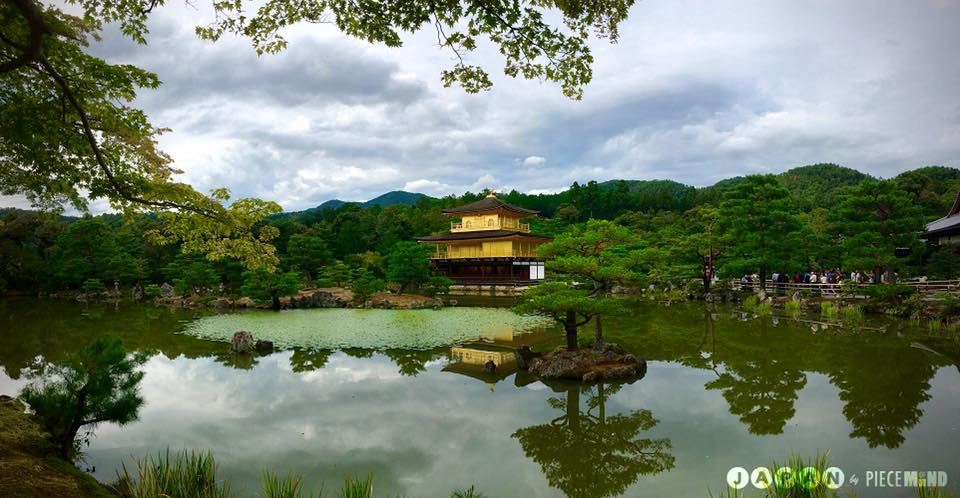


If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.



  0% (1 of 200) |                        | Elapsed Time: 0:00:00 ETA:   0:01:05

 total loss:455022528.0 style_loss:455022528.0 content_loss:6.20981097654294e-07 variation_loss:743651700.0


  1% (2 of 200) |                        | Elapsed Time: 0:00:00 ETA:   0:01:01

 total loss:275421856.0 style_loss:274604960.0 content_loss:816885.4375 variation_loss:888355680.0


  1% (3 of 200) |                        | Elapsed Time: 0:00:00 ETA:   0:01:00

 total loss:161614544.0 style_loss:160067360.0 content_loss:1547178.125 variation_loss:1032740400.0


  2% (4 of 200) |                        | Elapsed Time: 0:00:01 ETA:   0:00:59

 total loss:111660864.0 style_loss:109749992.0 content_loss:1910870.625 variation_loss:1173983280.0


  2% (5 of 200) |                        | Elapsed Time: 0:00:01 ETA:   0:00:58

 total loss:93808832.0 style_loss:91765944.0 content_loss:2042884.75 variation_loss:1293152760.0


  3% (6 of 200) |                        | Elapsed Time: 0:00:01 ETA:   0:00:58

 total loss:79709288.0 style_loss:77645632.0 content_loss:2063652.625 variation_loss:1384300320.0


  3% (7 of 200) |                        | Elapsed Time: 0:00:02 ETA:   0:00:58

 total loss:65927728.0 style_loss:63876484.0 content_loss:2051244.875 variation_loss:1452232560.0


  4% (8 of 200) |                        | Elapsed Time: 0:00:02 ETA:   0:00:56

 total loss:53361316.0 style_loss:51309996.0 content_loss:2051319.625 variation_loss:1503112200.0


  4% (9 of 200) |#                       | Elapsed Time: 0:00:02 ETA:   0:00:56

 total loss:42864520.0 style_loss:40788960.0 content_loss:2075558.125 variation_loss:1542842400.0


  5% (10 of 200) |#                      | Elapsed Time: 0:00:03 ETA:   0:00:56

 total loss:34890032.0 style_loss:32779346.0 content_loss:2110687.5 variation_loss:1575910080.0


  5% (11 of 200) |#                      | Elapsed Time: 0:00:03 ETA:   0:00:56

 total loss:29117632.0 style_loss:26974658.0 content_loss:2142975.0 variation_loss:1605222720.0


  6% (12 of 200) |#                      | Elapsed Time: 0:00:03 ETA:   0:00:55

 total loss:24809006.0 style_loss:22645320.0 content_loss:2163685.75 variation_loss:1632300960.0


  6% (13 of 200) |#                      | Elapsed Time: 0:00:03 ETA:   0:00:55

 total loss:21426100.0 style_loss:19251444.0 content_loss:2174656.75 variation_loss:1657729680.0


  7% (14 of 200) |#                      | Elapsed Time: 0:00:04 ETA:   0:00:55

 total loss:18725372.0 style_loss:16539572.0 content_loss:2185799.5 variation_loss:1681592520.0


  7% (15 of 200) |#                      | Elapsed Time: 0:00:04 ETA:   0:00:55

 total loss:16678304.0 style_loss:14478045.0 content_loss:2200258.5 variation_loss:1703849520.0


  8% (16 of 200) |#                      | Elapsed Time: 0:00:04 ETA:   0:00:55

 total loss:15211633.0 style_loss:12997979.0 content_loss:2213654.0 variation_loss:1724485680.0


  8% (17 of 200) |#                      | Elapsed Time: 0:00:05 ETA:   0:00:55

 total loss:14000806.0 style_loss:11781959.0 content_loss:2218847.5 variation_loss:1743439440.0


  9% (18 of 200) |##                     | Elapsed Time: 0:00:05 ETA:   0:00:55

 total loss:12864763.0 style_loss:10650359.0 content_loss:2214404.25 variation_loss:1760620080.0


  9% (19 of 200) |##                     | Elapsed Time: 0:00:05 ETA:   0:00:54

 total loss:11882481.0 style_loss:9679734.0 content_loss:2202747.0 variation_loss:1775969040.0


 10% (20 of 200) |##                     | Elapsed Time: 0:00:06 ETA:   0:00:54

 total loss:11041807.0 style_loss:8852410.0 content_loss:2189397.0 variation_loss:1789515840.0


 10% (21 of 200) |##                     | Elapsed Time: 0:00:06 ETA:   0:00:54

 total loss:10268943.0 style_loss:8094105.0 content_loss:2174838.0 variation_loss:1801485240.0


 11% (22 of 200) |##                     | Elapsed Time: 0:00:06 ETA:   0:00:54

 total loss:9587753.0 style_loss:7431338.0 content_loss:2156415.0 variation_loss:1812265920.0


 11% (23 of 200) |##                     | Elapsed Time: 0:00:06 ETA:   0:00:54

 total loss:9010772.0 style_loss:6877306.5 content_loss:2133465.5 variation_loss:1822269840.0


 12% (24 of 200) |##                     | Elapsed Time: 0:00:07 ETA:   0:00:53

 total loss:8502819.0 style_loss:6394393.5 content_loss:2108425.25 variation_loss:1831728600.0


 12% (25 of 200) |##                     | Elapsed Time: 0:00:07 ETA:   0:00:53

 total loss:8043221.0 style_loss:5957888.5 content_loss:2085332.75 variation_loss:1840664040.0


 13% (26 of 200) |##                     | Elapsed Time: 0:00:07 ETA:   0:00:53

 total loss:7639562.5 style_loss:5574632.0 content_loss:2064930.625 variation_loss:1848983520.0


 13% (27 of 200) |###                    | Elapsed Time: 0:00:08 ETA:   0:00:53

 total loss:7289624.5 style_loss:5244033.5 content_loss:2045591.125 variation_loss:1856566560.0


 14% (28 of 200) |###                    | Elapsed Time: 0:00:08 ETA:   0:00:52

 total loss:6971589.0 style_loss:4947368.0 content_loss:2024221.125 variation_loss:1863313440.0


 14% (29 of 200) |###                    | Elapsed Time: 0:00:08 ETA:   0:00:52

 total loss:6684191.5 style_loss:4683327.0 content_loss:2000864.5 variation_loss:1869220320.0


 15% (30 of 200) |###                    | Elapsed Time: 0:00:09 ETA:   0:00:51

 total loss:6412824.0 style_loss:4435211.0 content_loss:1977613.25 variation_loss:1874373120.0


 15% (31 of 200) |###                    | Elapsed Time: 0:00:09 ETA:   0:00:51

 total loss:6143518.0 style_loss:4187536.0 content_loss:1955981.75 variation_loss:1878903360.0


 16% (32 of 200) |###                    | Elapsed Time: 0:00:09 ETA:   0:00:51

 total loss:5898946.0 style_loss:3963791.5 content_loss:1935154.25 variation_loss:1882944720.0


 16% (33 of 200) |###                    | Elapsed Time: 0:00:09 ETA:   0:00:50

 total loss:5687859.0 style_loss:3774060.75 content_loss:1913798.375 variation_loss:1886543520.0


 17% (34 of 200) |###                    | Elapsed Time: 0:00:10 ETA:   0:00:50

 total loss:5498984.0 style_loss:3607266.5 content_loss:1891717.625 variation_loss:1889661360.0


 17% (35 of 200) |####                   | Elapsed Time: 0:00:10 ETA:   0:00:50

 total loss:5322543.0 style_loss:3452274.75 content_loss:1870268.25 variation_loss:1892243760.0


 18% (36 of 200) |####                   | Elapsed Time: 0:00:10 ETA:   0:00:49

 total loss:5149658.0 style_loss:3299547.5 content_loss:1850110.375 variation_loss:1894302720.0


 18% (37 of 200) |####                   | Elapsed Time: 0:00:11 ETA:   0:00:49

 total loss:4991538.5 style_loss:3161230.0 content_loss:1830308.625 variation_loss:1895955240.0


 19% (38 of 200) |####                   | Elapsed Time: 0:00:11 ETA:   0:00:49

 total loss:4852544.5 style_loss:3042782.0 content_loss:1809762.5 variation_loss:1897359840.0


 19% (39 of 200) |####                   | Elapsed Time: 0:00:11 ETA:   0:00:48

 total loss:4717571.0 style_loss:2928669.0 content_loss:1788901.75 variation_loss:1898649600.0


 20% (40 of 200) |####                   | Elapsed Time: 0:00:12 ETA:   0:00:48

 total loss:4581828.5 style_loss:2812669.5 content_loss:1769159.125 variation_loss:1899896040.0


 20% (41 of 200) |####                   | Elapsed Time: 0:00:12 ETA:   0:00:48

 total loss:4456831.0 style_loss:2706466.5 content_loss:1750364.5 variation_loss:1901114640.0


 21% (42 of 200) |####                   | Elapsed Time: 0:00:12 ETA:   0:00:48

 total loss:4345380.0 style_loss:2614055.25 content_loss:1731324.625 variation_loss:1902287880.0


 21% (43 of 200) |####                   | Elapsed Time: 0:00:13 ETA:   0:00:47

 total loss:4237026.0 style_loss:2525864.5 content_loss:1711161.25 variation_loss:1903368960.0


 22% (44 of 200) |#####                  | Elapsed Time: 0:00:13 ETA:   0:00:47

 total loss:4134189.0 style_loss:2443100.0 content_loss:1691089.125 variation_loss:1904295600.0


 22% (45 of 200) |#####                  | Elapsed Time: 0:00:13 ETA:   0:00:47

 total loss:4037378.25 style_loss:2364617.5 content_loss:1672760.75 variation_loss:1905006000.0


 23% (46 of 200) |#####                  | Elapsed Time: 0:00:13 ETA:   0:00:46

 total loss:3944915.5 style_loss:2288733.75 content_loss:1656181.875 variation_loss:1905473760.0


 23% (47 of 200) |#####                  | Elapsed Time: 0:00:14 ETA:   0:00:46

 total loss:3858456.25 style_loss:2218606.75 content_loss:1639849.5 variation_loss:1905694800.0


 24% (48 of 200) |#####                  | Elapsed Time: 0:00:14 ETA:   0:00:45

 total loss:3776868.5 style_loss:2153901.0 content_loss:1622967.5 variation_loss:1905692280.0


 24% (49 of 200) |#####                  | Elapsed Time: 0:00:14 ETA:   0:00:45

 total loss:3699817.5 style_loss:2093504.75 content_loss:1606312.625 variation_loss:1905509880.0


 25% (50 of 200) |#####                  | Elapsed Time: 0:00:15 ETA:   0:00:45

 total loss:3625164.5 style_loss:2034510.5 content_loss:1590653.875 variation_loss:1905210840.0


 25% (51 of 200) |#####                  | Elapsed Time: 0:00:15 ETA:   0:00:45

 total loss:3554302.0 style_loss:1978768.875 content_loss:1575533.25 variation_loss:1904868360.0


 26% (52 of 200) |#####                  | Elapsed Time: 0:00:15 ETA:   0:00:45

 total loss:3487884.0 style_loss:1927671.125 content_loss:1560212.875 variation_loss:1904541600.0


 26% (53 of 200) |######                 | Elapsed Time: 0:00:16 ETA:   0:00:44

 total loss:3424215.0 style_loss:1879274.25 content_loss:1544940.875 variation_loss:1904247840.0


 27% (54 of 200) |######                 | Elapsed Time: 0:00:16 ETA:   0:00:44

 total loss:3362531.0 style_loss:1832021.25 content_loss:1530509.75 variation_loss:1903962600.0


 27% (55 of 200) |######                 | Elapsed Time: 0:00:16 ETA:   0:00:44

 total loss:3304437.0 style_loss:1787491.375 content_loss:1516945.75 variation_loss:1903643280.0


 28% (56 of 200) |######                 | Elapsed Time: 0:00:16 ETA:   0:00:43

 total loss:3249037.25 style_loss:1745649.125 content_loss:1503388.125 variation_loss:1903253280.0


 28% (57 of 200) |######                 | Elapsed Time: 0:00:17 ETA:   0:00:43

 total loss:3195929.0 style_loss:1706484.75 content_loss:1489444.125 variation_loss:1902780000.0


 28% (58 of 200) |######                 | Elapsed Time: 0:00:17 ETA:   0:00:43

 total loss:3145575.5 style_loss:1669972.75 content_loss:1475602.875 variation_loss:1902236280.0


 29% (59 of 200) |######                 | Elapsed Time: 0:00:17 ETA:   0:00:42

 total loss:3097048.25 style_loss:1634773.875 content_loss:1462274.375 variation_loss:1901639280.0


 30% (60 of 200) |######                 | Elapsed Time: 0:00:18 ETA:   0:00:42

 total loss:3050360.5 style_loss:1601007.0 content_loss:1449353.625 variation_loss:1900987920.0


 30% (61 of 200) |#######                | Elapsed Time: 0:00:18 ETA:   0:00:42

 total loss:3004989.0 style_loss:1568291.75 content_loss:1436697.375 variation_loss:1900278240.0


 31% (62 of 200) |#######                | Elapsed Time: 0:00:18 ETA:   0:00:42

 total loss:2961784.75 style_loss:1537399.625 content_loss:1424385.125 variation_loss:1899528720.0


 31% (63 of 200) |#######                | Elapsed Time: 0:00:19 ETA:   0:00:41

 total loss:2920976.75 style_loss:1508495.125 content_loss:1412481.625 variation_loss:1898800440.0


 32% (64 of 200) |#######                | Elapsed Time: 0:00:19 ETA:   0:00:41

 total loss:2881764.0 style_loss:1481050.375 content_loss:1400713.5 variation_loss:1898159400.0


 32% (65 of 200) |#######                | Elapsed Time: 0:00:19 ETA:   0:00:41

 total loss:2843203.0 style_loss:1454012.125 content_loss:1389190.875 variation_loss:1897621560.0


 33% (66 of 200) |#######                | Elapsed Time: 0:00:20 ETA:   0:00:40

 total loss:2806113.25 style_loss:1427823.75 content_loss:1378289.5 variation_loss:1897128360.0


 33% (67 of 200) |#######                | Elapsed Time: 0:00:20 ETA:   0:00:40

 total loss:2771037.75 style_loss:1403158.875 content_loss:1367878.875 variation_loss:1896583440.0


 34% (68 of 200) |#######                | Elapsed Time: 0:00:20 ETA:   0:00:40

 total loss:2737013.5 style_loss:1379610.75 content_loss:1357402.875 variation_loss:1895927640.0


 34% (69 of 200) |#######                | Elapsed Time: 0:00:20 ETA:   0:00:40

 total loss:2703741.0 style_loss:1357075.625 content_loss:1346665.25 variation_loss:1895189760.0


 35% (70 of 200) |########               | Elapsed Time: 0:00:21 ETA:   0:00:39

 total loss:2672094.5 style_loss:1335773.5 content_loss:1336321.0 variation_loss:1894458720.0


 35% (71 of 200) |########               | Elapsed Time: 0:00:21 ETA:   0:00:39

 total loss:2641466.0 style_loss:1314793.625 content_loss:1326672.5 variation_loss:1893806760.0


 36% (72 of 200) |########               | Elapsed Time: 0:00:21 ETA:   0:00:39

 total loss:2611789.0 style_loss:1294507.625 content_loss:1317281.5 variation_loss:1893235440.0


 36% (73 of 200) |########               | Elapsed Time: 0:00:22 ETA:   0:00:38

 total loss:2583114.5 style_loss:1275287.0 content_loss:1307827.5 variation_loss:1892692800.0


 37% (74 of 200) |########               | Elapsed Time: 0:00:22 ETA:   0:00:38

 total loss:2555425.5 style_loss:1256814.0 content_loss:1298611.5 variation_loss:1892121720.0


 37% (75 of 200) |########               | Elapsed Time: 0:00:22 ETA:   0:00:38

 total loss:2528513.25 style_loss:1238584.25 content_loss:1289929.0 variation_loss:1891501440.0


 38% (76 of 200) |########               | Elapsed Time: 0:00:23 ETA:   0:00:37

 total loss:2502371.5 style_loss:1220838.5 content_loss:1281532.875 variation_loss:1890850200.0


 38% (77 of 200) |########               | Elapsed Time: 0:00:23 ETA:   0:00:37

 total loss:2476933.0 style_loss:1203820.125 content_loss:1273112.75 variation_loss:1890201960.0


 39% (78 of 200) |########               | Elapsed Time: 0:00:23 ETA:   0:00:37

 total loss:2452283.25 style_loss:1187560.875 content_loss:1264722.375 variation_loss:1889584680.0


 39% (79 of 200) |#########              | Elapsed Time: 0:00:24 ETA:   0:00:37

 total loss:2428425.75 style_loss:1171940.875 content_loss:1256484.875 variation_loss:1889004120.0


 40% (80 of 200) |#########              | Elapsed Time: 0:00:24 ETA:   0:00:36

 total loss:2405113.25 style_loss:1156759.0 content_loss:1248354.25 variation_loss:1888442280.0


 40% (81 of 200) |#########              | Elapsed Time: 0:00:24 ETA:   0:00:36

 total loss:2382438.5 style_loss:1142055.125 content_loss:1240383.25 variation_loss:1887875280.0


 41% (82 of 200) |#########              | Elapsed Time: 0:00:24 ETA:   0:00:36

 total loss:2360397.0 style_loss:1127694.875 content_loss:1232702.0 variation_loss:1887288360.0


 41% (83 of 200) |#########              | Elapsed Time: 0:00:25 ETA:   0:00:36

 total loss:2338910.0 style_loss:1113653.5 content_loss:1225256.5 variation_loss:1886689080.0


 42% (84 of 200) |#########              | Elapsed Time: 0:00:25 ETA:   0:00:35

 total loss:2317990.5 style_loss:1100042.25 content_loss:1217948.375 variation_loss:1886100360.0


 42% (85 of 200) |#########              | Elapsed Time: 0:00:25 ETA:   0:00:35

 total loss:2297608.0 style_loss:1086775.875 content_loss:1210832.125 variation_loss:1885541040.0


 43% (86 of 200) |#########              | Elapsed Time: 0:00:26 ETA:   0:00:35

 total loss:2277784.0 style_loss:1073887.0 content_loss:1203897.125 variation_loss:1885015920.0


 43% (87 of 200) |##########             | Elapsed Time: 0:00:26 ETA:   0:00:34

 total loss:2258502.5 style_loss:1061495.0 content_loss:1197007.625 variation_loss:1884515040.0


 44% (88 of 200) |##########             | Elapsed Time: 0:00:26 ETA:   0:00:34

 total loss:2239679.5 style_loss:1049522.5 content_loss:1190156.875 variation_loss:1884019920.0


 44% (89 of 200) |##########             | Elapsed Time: 0:00:27 ETA:   0:00:34

 total loss:2221284.5 style_loss:1037761.0 content_loss:1183523.625 variation_loss:1883514600.0


 45% (90 of 200) |##########             | Elapsed Time: 0:00:27 ETA:   0:00:33

 total loss:2203297.5 style_loss:1026245.5 content_loss:1177051.875 variation_loss:1882988640.0


 45% (91 of 200) |##########             | Elapsed Time: 0:00:27 ETA:   0:00:33

 total loss:2185743.5 style_loss:1015192.75 content_loss:1170550.625 variation_loss:1882453560.0


 46% (92 of 200) |##########             | Elapsed Time: 0:00:28 ETA:   0:00:33

 total loss:2168616.25 style_loss:1004567.8125 content_loss:1164048.5 variation_loss:1881939720.0


 46% (93 of 200) |##########             | Elapsed Time: 0:00:28 ETA:   0:00:33

 total loss:2151839.5 style_loss:994073.0 content_loss:1157766.375 variation_loss:1881473040.0


 47% (94 of 200) |##########             | Elapsed Time: 0:00:28 ETA:   0:00:32

 total loss:2135406.0 style_loss:983735.125 content_loss:1151670.75 variation_loss:1881048600.0


 47% (95 of 200) |##########             | Elapsed Time: 0:00:28 ETA:   0:00:32

 total loss:2119354.0 style_loss:973714.75 content_loss:1145639.125 variation_loss:1880637360.0


 48% (96 of 200) |###########            | Elapsed Time: 0:00:29 ETA:   0:00:31

 total loss:2103584.5 style_loss:963940.1875 content_loss:1139644.375 variation_loss:1880214840.0


 48% (97 of 200) |###########            | Elapsed Time: 0:00:29 ETA:   0:00:31

 total loss:2088129.125 style_loss:954371.875 content_loss:1133757.25 variation_loss:1879781520.0


 49% (98 of 200) |###########            | Elapsed Time: 0:00:29 ETA:   0:00:31

 total loss:2073006.75 style_loss:945081.3125 content_loss:1127925.375 variation_loss:1879352640.0


 49% (99 of 200) |###########            | Elapsed Time: 0:00:30 ETA:   0:00:31

 total loss:2058201.0 style_loss:936057.25 content_loss:1122143.75 variation_loss:1878937200.0


 50% (100 of 200) |###########           | Elapsed Time: 0:00:30 ETA:   0:00:30

 total loss:2043689.5 style_loss:927254.4375 content_loss:1116435.0 variation_loss:1878530880.0


 50% (101 of 200) |###########           | Elapsed Time: 0:00:30 ETA:   0:00:30

 total loss:2029468.375 style_loss:918695.125 content_loss:1110773.25 variation_loss:1878127440.0


 51% (102 of 200) |###########           | Elapsed Time: 0:00:31 ETA:   0:00:30

 total loss:2015531.0 style_loss:910313.8125 content_loss:1105217.125 variation_loss:1877728080.0


 51% (103 of 200) |###########           | Elapsed Time: 0:00:31 ETA:   0:00:30

 total loss:2001884.0 style_loss:902046.0625 content_loss:1099837.875 variation_loss:1877339760.0


 52% (104 of 200) |###########           | Elapsed Time: 0:00:31 ETA:   0:00:29

 total loss:1988482.0 style_loss:893921.75 content_loss:1094560.25 variation_loss:1876967880.0


 52% (105 of 200) |###########           | Elapsed Time: 0:00:32 ETA:   0:00:29

 total loss:1975350.75 style_loss:886046.875 content_loss:1089303.875 variation_loss:1876609920.0


 53% (106 of 200) |###########           | Elapsed Time: 0:00:32 ETA:   0:00:29

 total loss:1962467.5 style_loss:878353.25 content_loss:1084114.25 variation_loss:1876263360.0


 53% (107 of 200) |###########           | Elapsed Time: 0:00:32 ETA:   0:00:28

 total loss:1949835.25 style_loss:870807.8125 content_loss:1079027.375 variation_loss:1875924000.0


 54% (108 of 200) |###########           | Elapsed Time: 0:00:32 ETA:   0:00:28

 total loss:1937451.5 style_loss:863448.0 content_loss:1074003.5 variation_loss:1875583680.0


 54% (109 of 200) |###########           | Elapsed Time: 0:00:33 ETA:   0:00:28

 total loss:1925301.875 style_loss:856257.25 content_loss:1069044.625 variation_loss:1875236040.0


 55% (110 of 200) |############          | Elapsed Time: 0:00:33 ETA:   0:00:27

 total loss:1913381.125 style_loss:849158.875 content_loss:1064222.25 variation_loss:1874885040.0


 55% (111 of 200) |############          | Elapsed Time: 0:00:33 ETA:   0:00:27

 total loss:1901679.75 style_loss:842173.5625 content_loss:1059506.125 variation_loss:1874540880.0


 56% (112 of 200) |############          | Elapsed Time: 0:00:34 ETA:   0:00:27

 total loss:1890176.25 style_loss:835349.75 content_loss:1054826.5 variation_loss:1874214360.0


 56% (113 of 200) |############          | Elapsed Time: 0:00:34 ETA:   0:00:26

 total loss:1878882.5 style_loss:828657.125 content_loss:1050225.375 variation_loss:1873907880.0


 56% (114 of 200) |############          | Elapsed Time: 0:00:34 ETA:   0:00:26

 total loss:1867785.75 style_loss:822056.5625 content_loss:1045729.25 variation_loss:1873614000.0


 57% (115 of 200) |############          | Elapsed Time: 0:00:35 ETA:   0:00:26

 total loss:1856874.375 style_loss:815598.125 content_loss:1041276.25 variation_loss:1873320360.0


 57% (116 of 200) |############          | Elapsed Time: 0:00:35 ETA:   0:00:25

 total loss:1846147.5 style_loss:809297.0 content_loss:1036850.5625 variation_loss:1873021320.0


 58% (117 of 200) |############          | Elapsed Time: 0:00:35 ETA:   0:00:25

 total loss:1835599.0 style_loss:803136.0625 content_loss:1032463.0 variation_loss:1872721320.0


 59% (118 of 200) |############          | Elapsed Time: 0:00:36 ETA:   0:00:25

 total loss:1825217.25 style_loss:797106.125 content_loss:1028111.0625 variation_loss:1872430440.0


 59% (119 of 200) |#############         | Elapsed Time: 0:00:36 ETA:   0:00:24

 total loss:1815009.375 style_loss:791199.75 content_loss:1023809.625 variation_loss:1872153360.0


 60% (120 of 200) |#############         | Elapsed Time: 0:00:36 ETA:   0:00:24

 total loss:1804970.875 style_loss:785397.8125 content_loss:1019573.0625 variation_loss:1871886240.0


 60% (121 of 200) |#############         | Elapsed Time: 0:00:36 ETA:   0:00:24

 total loss:1795089.25 style_loss:779705.125 content_loss:1015384.125 variation_loss:1871621640.0


 61% (122 of 200) |#############         | Elapsed Time: 0:00:37 ETA:   0:00:23

 total loss:1785357.0 style_loss:774102.0625 content_loss:1011254.9375 variation_loss:1871357280.0


 61% (123 of 200) |#############         | Elapsed Time: 0:00:37 ETA:   0:00:23

 total loss:1775771.5 style_loss:768586.8125 content_loss:1007184.625 variation_loss:1871098080.0


 62% (124 of 200) |#############         | Elapsed Time: 0:00:37 ETA:   0:00:23

 total loss:1766333.75 style_loss:763174.125 content_loss:1003159.5625 variation_loss:1870847040.0


 62% (125 of 200) |#############         | Elapsed Time: 0:00:38 ETA:   0:00:22

 total loss:1757044.875 style_loss:757875.5 content_loss:999169.375 variation_loss:1870601280.0


 63% (126 of 200) |#############         | Elapsed Time: 0:00:38 ETA:   0:00:22

 total loss:1747907.0 style_loss:752671.5 content_loss:995235.4375 variation_loss:1870357920.0


 63% (127 of 200) |#############         | Elapsed Time: 0:00:38 ETA:   0:00:22

 total loss:1738897.75 style_loss:747559.25 content_loss:991338.5 variation_loss:1870117680.0


 64% (128 of 200) |##############        | Elapsed Time: 0:00:39 ETA:   0:00:21

 total loss:1730017.75 style_loss:742536.625 content_loss:987481.1875 variation_loss:1869885120.0


 64% (129 of 200) |##############        | Elapsed Time: 0:00:39 ETA:   0:00:21

 total loss:1721277.75 style_loss:737578.5625 content_loss:983699.25 variation_loss:1869661920.0


 65% (130 of 200) |##############        | Elapsed Time: 0:00:39 ETA:   0:00:21

 total loss:1712670.5 style_loss:732701.4375 content_loss:979969.125 variation_loss:1869445440.0


 65% (131 of 200) |##############        | Elapsed Time: 0:00:40 ETA:   0:00:20

 total loss:1704186.25 style_loss:727912.9375 content_loss:976273.25 variation_loss:1869234000.0


 66% (132 of 200) |##############        | Elapsed Time: 0:00:40 ETA:   0:00:20

 total loss:1695827.0 style_loss:723185.5 content_loss:972641.4375 variation_loss:1869027480.0


 66% (133 of 200) |##############        | Elapsed Time: 0:00:40 ETA:   0:00:20

 total loss:1687577.25 style_loss:718507.125 content_loss:969070.0625 variation_loss:1868826960.0


 67% (134 of 200) |##############        | Elapsed Time: 0:00:40 ETA:   0:00:20

 total loss:1679436.875 style_loss:713915.8125 content_loss:965521.0625 variation_loss:1868631360.0


 67% (135 of 200) |##############        | Elapsed Time: 0:00:41 ETA:   0:00:19

 total loss:1671414.0 style_loss:709421.25 content_loss:961992.6875 variation_loss:1868439840.0


 68% (136 of 200) |##############        | Elapsed Time: 0:00:41 ETA:   0:00:19

 total loss:1663499.0 style_loss:704988.4375 content_loss:958510.5 variation_loss:1868252400.0


 68% (137 of 200) |###############       | Elapsed Time: 0:00:41 ETA:   0:00:19

 total loss:1655689.5 style_loss:700606.25 content_loss:955083.25 variation_loss:1868069040.0


 69% (138 of 200) |###############       | Elapsed Time: 0:00:42 ETA:   0:00:18

 total loss:1647979.5 style_loss:696278.9375 content_loss:951700.5 variation_loss:1867889520.0


 69% (139 of 200) |###############       | Elapsed Time: 0:00:42 ETA:   0:00:18

 total loss:1640368.25 style_loss:692002.0625 content_loss:948366.125 variation_loss:1867716720.0


 70% (140 of 200) |###############       | Elapsed Time: 0:00:42 ETA:   0:00:18

 total loss:1632850.0 style_loss:687789.5625 content_loss:945060.375 variation_loss:1867553640.0


 70% (141 of 200) |###############       | Elapsed Time: 0:00:43 ETA:   0:00:18

 total loss:1625435.375 style_loss:683628.0 content_loss:941807.375 variation_loss:1867400040.0


 71% (142 of 200) |###############       | Elapsed Time: 0:00:43 ETA:   0:00:17

 total loss:1618122.5 style_loss:679527.875 content_loss:938594.6875 variation_loss:1867250880.0


 71% (143 of 200) |###############       | Elapsed Time: 0:00:43 ETA:   0:00:17

 total loss:1610896.875 style_loss:675496.625 content_loss:935400.25 variation_loss:1867104480.0


 72% (144 of 200) |###############       | Elapsed Time: 0:00:43 ETA:   0:00:17

 total loss:1603759.125 style_loss:671514.9375 content_loss:932244.1875 variation_loss:1866961200.0


 72% (145 of 200) |###############       | Elapsed Time: 0:00:44 ETA:   0:00:16

 total loss:1596705.5 style_loss:667592.0625 content_loss:929113.375 variation_loss:1866823440.0


 73% (146 of 200) |################      | Elapsed Time: 0:00:44 ETA:   0:00:16

 total loss:1589742.875 style_loss:663731.8125 content_loss:926011.0625 variation_loss:1866691440.0


 73% (147 of 200) |################      | Elapsed Time: 0:00:44 ETA:   0:00:16

 total loss:1582880.75 style_loss:659920.875 content_loss:922959.9375 variation_loss:1866564000.0


 74% (148 of 200) |################      | Elapsed Time: 0:00:45 ETA:   0:00:15

 total loss:1576099.75 style_loss:656161.25 content_loss:919938.5625 variation_loss:1866438120.0


 74% (149 of 200) |################      | Elapsed Time: 0:00:45 ETA:   0:00:15

 total loss:1569398.375 style_loss:652459.125 content_loss:916939.25 variation_loss:1866313200.0


 75% (150 of 200) |################      | Elapsed Time: 0:00:45 ETA:   0:00:15

 total loss:1562788.875 style_loss:648804.5625 content_loss:913984.3125 variation_loss:1866190560.0


 75% (151 of 200) |################      | Elapsed Time: 0:00:46 ETA:   0:00:14

 total loss:1556261.125 style_loss:645200.875 content_loss:911060.25 variation_loss:1866072840.0


 76% (152 of 200) |################      | Elapsed Time: 0:00:46 ETA:   0:00:14

 total loss:1549811.5 style_loss:641639.875 content_loss:908171.6875 variation_loss:1865961600.0


 76% (153 of 200) |################      | Elapsed Time: 0:00:46 ETA:   0:00:14

 total loss:1543448.125 style_loss:638122.5625 content_loss:905325.5625 variation_loss:1865856000.0


 77% (154 of 200) |################      | Elapsed Time: 0:00:47 ETA:   0:00:14

 total loss:1537165.5 style_loss:634646.375 content_loss:902519.0625 variation_loss:1865754480.0


 77% (155 of 200) |#################     | Elapsed Time: 0:00:47 ETA:   0:00:13

 total loss:1530968.0 style_loss:631214.8125 content_loss:899753.25 variation_loss:1865654640.0


 78% (156 of 200) |#################     | Elapsed Time: 0:00:47 ETA:   0:00:13

 total loss:1524848.375 style_loss:627829.875 content_loss:897018.5 variation_loss:1865556000.0


 78% (157 of 200) |#################     | Elapsed Time: 0:00:47 ETA:   0:00:13

 total loss:1518796.5 style_loss:624490.8125 content_loss:894305.625 variation_loss:1865459640.0


 79% (158 of 200) |#################     | Elapsed Time: 0:00:48 ETA:   0:00:12

 total loss:1512810.5 style_loss:621200.8125 content_loss:891609.75 variation_loss:1865367840.0


 79% (159 of 200) |#################     | Elapsed Time: 0:00:48 ETA:   0:00:12

 total loss:1506901.0 style_loss:617971.6875 content_loss:888929.3125 variation_loss:1865280240.0


 80% (160 of 200) |#################     | Elapsed Time: 0:00:48 ETA:   0:00:12

 total loss:1501063.5 style_loss:614798.8125 content_loss:886264.625 variation_loss:1865196360.0


 80% (161 of 200) |#################     | Elapsed Time: 0:00:49 ETA:   0:00:11

 total loss:1495287.5 style_loss:611669.8125 content_loss:883617.75 variation_loss:1865114280.0


 81% (162 of 200) |#################     | Elapsed Time: 0:00:49 ETA:   0:00:11

 total loss:1489582.0 style_loss:608580.75 content_loss:881001.25 variation_loss:1865034000.0


 81% (163 of 200) |#################     | Elapsed Time: 0:00:49 ETA:   0:00:11

 total loss:1483946.875 style_loss:605525.5 content_loss:878421.375 variation_loss:1864956120.0


 82% (164 of 200) |##################    | Elapsed Time: 0:00:50 ETA:   0:00:10

 total loss:1478378.5 style_loss:602502.6875 content_loss:875875.75 variation_loss:1864880520.0


 82% (165 of 200) |##################    | Elapsed Time: 0:00:50 ETA:   0:00:10

 total loss:1472873.125 style_loss:599512.875 content_loss:873360.25 variation_loss:1864805400.0


 83% (166 of 200) |##################    | Elapsed Time: 0:00:50 ETA:   0:00:10

 total loss:1467429.5 style_loss:596558.875 content_loss:870870.625 variation_loss:1864730160.0


 83% (167 of 200) |##################    | Elapsed Time: 0:00:50 ETA:   0:00:10

 total loss:1462045.25 style_loss:593641.6875 content_loss:868403.625 variation_loss:1864657200.0


 84% (168 of 200) |##################    | Elapsed Time: 0:00:51 ETA:   0:00:09

 total loss:1456715.75 style_loss:590766.125 content_loss:865949.625 variation_loss:1864589160.0


 84% (169 of 200) |##################    | Elapsed Time: 0:00:51 ETA:   0:00:09

 total loss:1451441.875 style_loss:587922.0625 content_loss:863519.8125 variation_loss:1864526160.0


 85% (170 of 200) |##################    | Elapsed Time: 0:00:51 ETA:   0:00:09

 total loss:1446215.0 style_loss:585121.875 content_loss:861093.0625 variation_loss:1864466880.0


 85% (171 of 200) |##################    | Elapsed Time: 0:00:52 ETA:   0:00:08

 total loss:1441035.0 style_loss:582342.0625 content_loss:858692.9375 variation_loss:1864411680.0


 86% (172 of 200) |##################    | Elapsed Time: 0:00:52 ETA:   0:00:08

 total loss:1435905.25 style_loss:579584.125 content_loss:856321.1875 variation_loss:1864359720.0


 86% (173 of 200) |###################   | Elapsed Time: 0:00:52 ETA:   0:00:08

 total loss:1430824.5 style_loss:576879.375 content_loss:853945.0625 variation_loss:1864308720.0


 87% (174 of 200) |###################   | Elapsed Time: 0:00:53 ETA:   0:00:07

 total loss:1425800.0 style_loss:574213.6875 content_loss:851586.375 variation_loss:1864259040.0


 87% (175 of 200) |###################   | Elapsed Time: 0:00:53 ETA:   0:00:07

 total loss:1420822.0 style_loss:571584.8125 content_loss:849237.1875 variation_loss:1864211520.0


 88% (176 of 200) |###################   | Elapsed Time: 0:00:53 ETA:   0:00:07

 total loss:1415896.0 style_loss:568990.4375 content_loss:846905.5625 variation_loss:1864168440.0


 88% (177 of 200) |###################   | Elapsed Time: 0:00:54 ETA:   0:00:06

 total loss:1411033.0 style_loss:566427.8125 content_loss:844605.125 variation_loss:1864129440.0


 89% (178 of 200) |###################   | Elapsed Time: 0:00:54 ETA:   0:00:06

 total loss:1406206.875 style_loss:563896.75 content_loss:842310.125 variation_loss:1864095720.0


 89% (179 of 200) |###################   | Elapsed Time: 0:00:54 ETA:   0:00:06

 total loss:1401428.5 style_loss:561387.9375 content_loss:840040.5625 variation_loss:1864064880.0


 90% (180 of 200) |###################   | Elapsed Time: 0:00:54 ETA:   0:00:06

 total loss:1396693.375 style_loss:558908.8125 content_loss:837784.5625 variation_loss:1864035120.0


 90% (181 of 200) |###################   | Elapsed Time: 0:00:55 ETA:   0:00:05

 total loss:1391998.875 style_loss:556450.875 content_loss:835548.0 variation_loss:1864006200.0


 91% (182 of 200) |####################  | Elapsed Time: 0:00:55 ETA:   0:00:05

 total loss:1387351.5 style_loss:554011.625 content_loss:833339.875 variation_loss:1863980400.0


 91% (183 of 200) |####################  | Elapsed Time: 0:00:55 ETA:   0:00:05

 total loss:1382747.75 style_loss:551595.3125 content_loss:831152.5 variation_loss:1863959280.0


 92% (184 of 200) |####################  | Elapsed Time: 0:00:56 ETA:   0:00:04

 total loss:1378189.25 style_loss:549200.375 content_loss:828988.9375 variation_loss:1863940920.0


 92% (185 of 200) |####################  | Elapsed Time: 0:00:56 ETA:   0:00:04

 total loss:1373677.125 style_loss:546821.5625 content_loss:826855.5625 variation_loss:1863923040.0


 93% (186 of 200) |####################  | Elapsed Time: 0:00:56 ETA:   0:00:04

 total loss:1369209.375 style_loss:544464.1875 content_loss:824745.1875 variation_loss:1863904800.0


 93% (187 of 200) |####################  | Elapsed Time: 0:00:57 ETA:   0:00:03

 total loss:1364772.25 style_loss:542130.875 content_loss:822641.375 variation_loss:1863888240.0


 94% (188 of 200) |####################  | Elapsed Time: 0:00:57 ETA:   0:00:03

 total loss:1360378.0 style_loss:539823.5625 content_loss:820554.375 variation_loss:1863875760.0


 94% (189 of 200) |####################  | Elapsed Time: 0:00:57 ETA:   0:00:03

 total loss:1356023.25 style_loss:537548.1875 content_loss:818475.125 variation_loss:1863866400.0


 95% (190 of 200) |####################  | Elapsed Time: 0:00:57 ETA:   0:00:03

 total loss:1351706.0 style_loss:535303.5625 content_loss:816402.5 variation_loss:1863856200.0


 95% (191 of 200) |##################### | Elapsed Time: 0:00:58 ETA:   0:00:02

 total loss:1347429.625 style_loss:533087.9375 content_loss:814341.6875 variation_loss:1863846000.0


 96% (192 of 200) |##################### | Elapsed Time: 0:00:58 ETA:   0:00:02

 total loss:1343191.25 style_loss:530891.0 content_loss:812300.25 variation_loss:1863838560.0


 96% (193 of 200) |##################### | Elapsed Time: 0:00:58 ETA:   0:00:02

 total loss:1338986.5 style_loss:528721.5625 content_loss:810264.875 variation_loss:1863833520.0


 97% (194 of 200) |##################### | Elapsed Time: 0:00:59 ETA:   0:00:01

 total loss:1334810.5 style_loss:526578.875 content_loss:808231.625 variation_loss:1863830280.0


 97% (195 of 200) |##################### | Elapsed Time: 0:00:59 ETA:   0:00:01

 total loss:1330672.375 style_loss:524456.8125 content_loss:806215.5625 variation_loss:1863828240.0


 98% (196 of 200) |##################### | Elapsed Time: 0:00:59 ETA:   0:00:01

 total loss:1326575.875 style_loss:522364.15625 content_loss:804211.6875 variation_loss:1863826800.0


 98% (197 of 200) |##################### | Elapsed Time: 0:01:00 ETA:   0:00:00

 total loss:1322516.875 style_loss:520288.90625 content_loss:802228.0 variation_loss:1863826560.0


 99% (198 of 200) |##################### | Elapsed Time: 0:01:00 ETA:   0:00:00

 total loss:1318489.125 style_loss:518231.21875 content_loss:800257.9375 variation_loss:1863830400.0


 99% (199 of 200) |##################### | Elapsed Time: 0:01:00 ETA:   0:00:00

 total loss:1314490.625 style_loss:516192.5625 content_loss:798298.0625 variation_loss:1863837120.0


100% (200 of 200) |######################| Elapsed Time: 0:01:00 Time:  0:01:00


 total loss:1310531.25 style_loss:514162.34375 content_loss:796368.875 variation_loss:1863843960.0


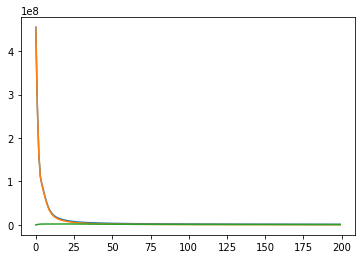

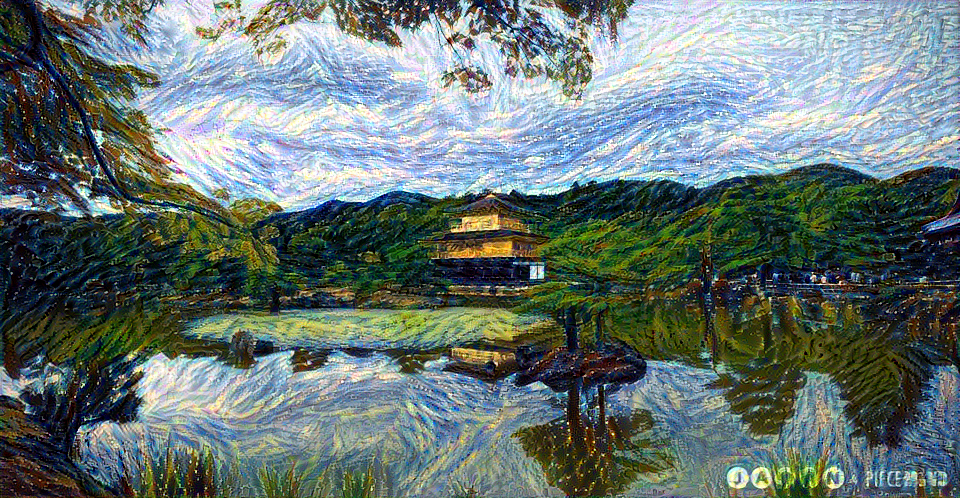



the intermediate outputs are :


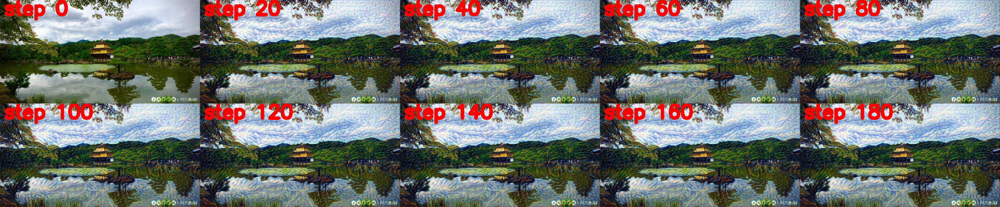

In [0]:
style_transfer_net = style_transfer('vgg19', 'content/content.jpg', 'styles/starry_night.jpg')
style_transfer_net.combine(200, 5, 'output.png', 'content')

output = cv2.imread('output.png')
intermediate_image = cv2.imread('intermediate_images.png')
w = 512
r = intermediate_image.shape[0] / w
intermediate_image = cv2.resize(intermediate_image, (int(intermediate_image.shape[1] / r), w))
cv2_imshow(output)

print ("\n\nthe intermediate outputs are :")
cv2_imshow(intermediate_image)

You can try out some other samples as well if you want, just clear the notebook outputs once before running again. Just change the path of the images in the code above to run on a different sample. You can also download the code from the repo and run it on your system directly.

https://github.com/Sambhav300899/Neural-Style-Transfer-TF

**References** - 
* Deep Learning with Python by François Chollet
* https://arxiv.org/abs/1705.04058
* https://towardsdatascience.comneural-style-transfer-tutorial-part-1-f5cd3315fa7f
* https://www.tensorflow.org/tutorials/generative/style_transfer
* https://towardsdatascience.com/neural-networks-intuitions-2-dot-product-gram-matrix-and-neural-style-transfer-5d39653e7916

**Some issues with the current implementation** - 
* It can't be run on very high resolution content or the GPU runs out of memory.
* This process can't be run in real time.
* A lot of sharp gradients pop up around some objects.

**Future Work** - 
* An image to image model can be trained on a set of styles and outputs generated with this technique to make it real time.
* CycleGAN can be used for real time style transfer for a given style.
* Figuring out a way to use with high resolution images(maybe downscale and then upscale with super resolution GAN, but that seems like a very naive solution).
* Adding a quality measure of the style transfer.

**Experiments which can be done** - 
* How changing the loss weights effects the output(a detailed study and not just changing and seeing visually).
* Seeing how additional pre processing such as blurring before updating the image might help.

**An experiment with starting points**       
By default the content image is passed as the initial target image to calculate the loss. What if we used some different images as the starting points instead.

**NOTE** - Please clear all outputs before running this or the notebook keeps getting disconnected. To clear all outputs (edit -> clear all outputs)

**NOTE** - Also note that running the following cells will take some time as the number of iterations has to be increased

In [0]:
'''
lets try giving the starting image as style now
'''
style_transfer_net = style_transfer('vgg19', 'content/content.jpg', 'styles/style.jpg')
style_transfer_net.combine(5000, 5, 'output.png', 'style')

output = cv2.imread('output.png')
intermediate_image = cv2.imread('intermediate_images.png')
w = 512
r = intermediate_image.shape[0] / w
intermediate_image = cv2.resize(intermediate_image, (int(intermediate_image.shape[1] / r), w))
cv2_imshow(output)

print ("\n\nthe intermediate outputs are :")
cv2_imshow(intermediate_image)

In [0]:
'''
lets try giving the starting image as zeros now
'''
style_transfer_net = style_transfer('vgg19', 'content/content.jpg', 'styles/style.jpg')
style_transfer_net.combine(5000, 5, 'output.png', 'zeros')

output = cv2.imread('output.png')
intermediate_image = cv2.imread('intermediate_images.png')
w = 512
r = intermediate_image.shape[0] / w
intermediate_image = cv2.resize(intermediate_image, (int(intermediate_image.shape[1] / r), w))
cv2_imshow(output)

print ("\n\nthe intermediate outputs are :")
cv2_imshow(intermediate_image)

In [0]:
'''
lets try giving the starting image as random now
'''
style_transfer_net = style_transfer('vgg19', 'content/content.jpg', 'styles/style.jpg')
style_transfer_net.combine(5000, 5, 'output.png', 'random')

output = cv2.imread('output.png')
intermediate_image = cv2.imread('intermediate_images.png')
w = 512
r = intermediate_image.shape[0] / w
intermediate_image = cv2.resize(intermediate_image, (int(intermediate_image.shape[1] / r), w))
cv2_imshow(output)

print ("\n\nthe intermediate outputs are :")
cv2_imshow(intermediate_image)